In [1]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Thu Feb  1 15:21:52 2024

@author: liza
"""

import numpy as np
# from scipy.sparse import csc_matrix
import scanpy as sc
import pandas as pd
import decoupler as dc

import matplotlib 

import matplotlib.pyplot as plt

import seaborn as sns
#
# import liana as li
#
# import session_info

sc.settings.set_figure_params(dpi=300, frameon=False, facecolor="white")
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()

plt.rcParams["font.family"] = "Arial"
sc.set_figure_params(figsize=(6, 6))
# Change global font weight


font = {'family' : 'Arial',
    'weight' : 'normal',
    'size'   : 20,
    'style'  : 'normal'}

matplotlib.rcParams['mathtext.fontset'] = 'custom'
matplotlib.rcParams['mathtext.rm'] = 'Arial'
matplotlib.rcParams['mathtext.it'] = 'Arial'


matplotlib.rc('font', **font)
#matplotlib.rc('font', **font0)
matplotlib.rc('text', usetex=False)

scanpy==1.9.8 anndata==0.10.5.post1 umap==0.5.5 numpy==1.26.4 scipy==1.12.0 pandas==2.2.1 scikit-learn==1.4.1.post1 statsmodels==0.14.1 igraph==0.11.4 pynndescent==0.5.11


In [2]:
# %% FROM SEURAT FILES GC

# Read the .mtx file along with the barcodes and gene names
adata_GC = sc.read_mtx("/home/liza/Documents/PhD/scRNAseq_Inbal/GC.mtx")
genes = pd.read_csv("/home/liza/Documents/PhD/scRNAseq_Inbal/GCgenes.tsv", header=None, sep='\t')[0]
barcodes = pd.read_csv("/home/liza/Documents/PhD/scRNAseq_Inbal/GCbarcodes.tsv", header=None, sep='\t')[0]

adata_GC = adata_GC.transpose()

# Check dimensions and assign names
if adata_GC.shape[1] == len(genes):
    # If the number of columns in adata.X matches the number of genes, assign var_names
    adata_GC.var_names = genes
    adata_GC.obs_names = barcodes
else:
    # If there's a mismatch, raise an error or alert
    raise ValueError("Mismatch between the number of genes and the number of columns in the AnnData object.")

# Assign the gene names and cell barcodes
adata_GC.var_names = genes
adata_GC.obs_names = barcodes

# Ensure that var_names and obs_names do not have duplicates
adata_GC.var_names_make_unique(join="-")
adata_GC.obs_names_make_unique(join="-")


In [3]:
# %% FROM SEURAT FILES GP

# Read the .mtx file along with the barcodes and gene names
adata_GP = sc.read_mtx("/home/liza/Documents/PhD/scRNAseq_Inbal/GP.mtx")
genes = pd.read_csv("/home/liza/Documents/PhD/scRNAseq_Inbal/GPgenes.tsv", header=None, sep='\t')[0]
barcodes = pd.read_csv("/home/liza/Documents/PhD/scRNAseq_Inbal/GPbarcodes.tsv", header=None, sep='\t')[0]

adata_GP = adata_GP.transpose()

# Check dimensions and assign names
if adata_GP.shape[1] == len(genes):
    # If the number of columns in adata.X matches the number of genes, assign var_names
    adata_GP.var_names = genes
    adata_GP.obs_names = barcodes
else:
    # If there's a mismatch, raise an error or alert
    raise ValueError("Mismatch between the number of genes and the number of columns in the AnnData object.")

# Assign the gene names and cell barcodes
adata_GP.var_names = genes
adata_GP.obs_names = barcodes

# Ensure that var_names and obs_names do not have duplicates
adata_GP.var_names_make_unique(join="-")
adata_GP.obs_names_make_unique(join="-")

In [4]:
# %%FROM SEURAT FILES WP

# Read the .mtx file along with the barcodes and gene names
adata_WP = sc.read_mtx("/home/liza/Documents/PhD/scRNAseq_Inbal/WP.mtx")
genes = pd.read_csv("/home/liza/Documents/PhD/scRNAseq_Inbal/WPgenes.tsv", header=None, sep='\t')[0]
barcodes = pd.read_csv("/home/liza/Documents/PhD/scRNAseq_Inbal/WPbarcodes.tsv", header=None, sep='\t')[0]

adata_WP = adata_WP.transpose()

# Check dimensions and assign names
if adata_WP.shape[1] == len(genes):
    # If the number of columns in adata.X matches the number of genes, assign var_names
    adata_WP.var_names = genes
    adata_WP.obs_names = barcodes
else:
    # If there's a mismatch, raise an error or alert
    raise ValueError("Mismatch between the number of genes and the number of columns in the AnnData object.")

# Assign the gene names and cell barcodes
adata_WP.var_names = genes
adata_WP.obs_names = barcodes

# Ensure that var_names and obs_names do not have duplicates
adata_WP.var_names_make_unique(join="-")
adata_WP.obs_names_make_unique(join="-")

In [5]:
# %% FROM SEURAT FILES WC

# Read the .mtx file along with the barcodes and gene names
adata_WC = sc.read_mtx("/home/liza/Documents/PhD/scRNAseq_Inbal/WC.mtx")
genes = pd.read_csv("/home/liza/Documents/PhD/scRNAseq_Inbal/WCgenes.tsv", header=None, sep='\t')[0]
barcodes = pd.read_csv("/home/liza/Documents/PhD/scRNAseq_Inbal/WCbarcodes.tsv", header=None, sep='\t')[0]

adata_WC = adata_WC.transpose()

# Check dimensions and assign names
if adata_WC.shape[1] == len(genes):
    # If the number of columns in adata.X matches the number of genes, assign var_names
    adata_WC.var_names = genes
    adata_WC.obs_names = barcodes
else:
    # If there's a mismatch, raise an error or alert
    raise ValueError("Mismatch between the number of genes and the number of columns in the AnnData object.")

# Assign the gene names and cell barcodes
adata_WC.var_names = genes
adata_WC.obs_names = barcodes

# Ensure that var_names and obs_names do not have duplicates
adata_WC.var_names_make_unique(join="-")
adata_WC.obs_names_make_unique(join="-")

In [6]:
# %%% Put all the data together

sc.pp.filter_cells(adata_GC, min_genes=200)
sc.pp.filter_genes(adata_GC, min_cells=10)

sc.pp.filter_cells(adata_GP, min_genes=200)
sc.pp.filter_genes(adata_GP, min_cells=10)

sc.pp.filter_cells(adata_WC, min_genes=200)
sc.pp.filter_genes(adata_WC, min_cells=10)

sc.pp.filter_cells(adata_WP, min_genes=200)
sc.pp.filter_genes(adata_WP, min_cells=10)

adata_GC.obs['sample'] = 'dblGATA_Control'
adata_GP.obs['sample'] = 'dblGATA_PyMT'
adata_WC.obs['sample'] = 'WT_Control'
adata_WP.obs['sample'] = 'WT_PyMT'

adata = sc.concat([adata_GC, adata_GP, adata_WC, adata_WP])

# Subset the adata object for dblGATA samples
adata_dblGATA = adata[adata.obs['sample'].isin(['dblGATA_Control', 'dblGATA_PyMT'])]

# Subset the adata object for WT samples
adata_WT = adata[adata.obs['sample'].isin(['WT_Control', 'WT_PyMT'])]

filtered out 17134 genes that are detected in less than 10 cells
filtered out 17413 genes that are detected in less than 10 cells
filtered out 18122 genes that are detected in less than 10 cells
filtered out 18046 genes that are detected in less than 10 cells


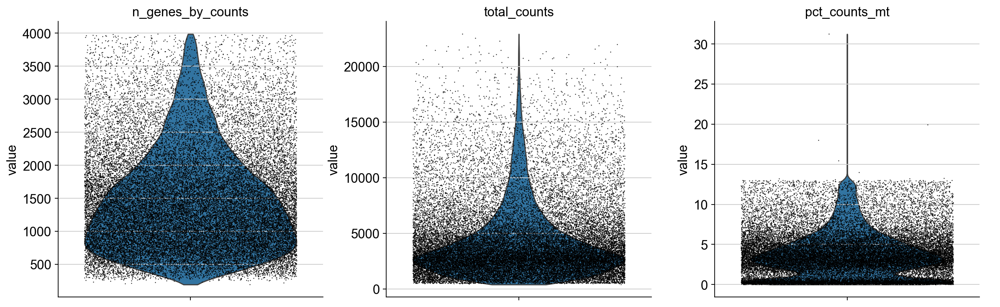

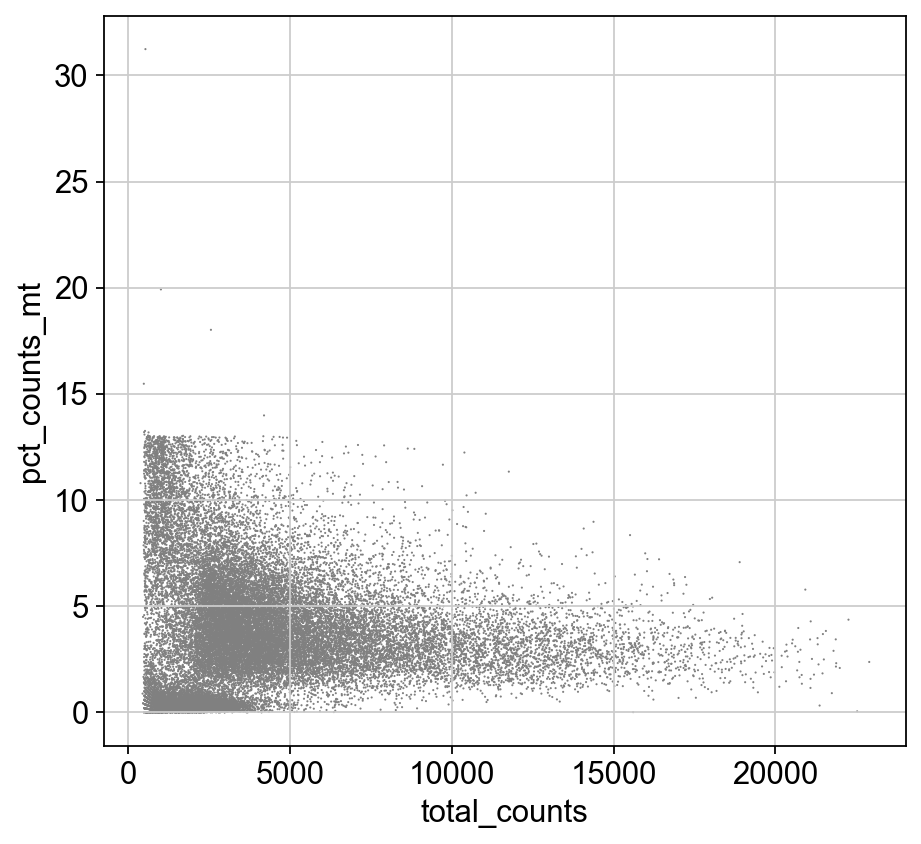

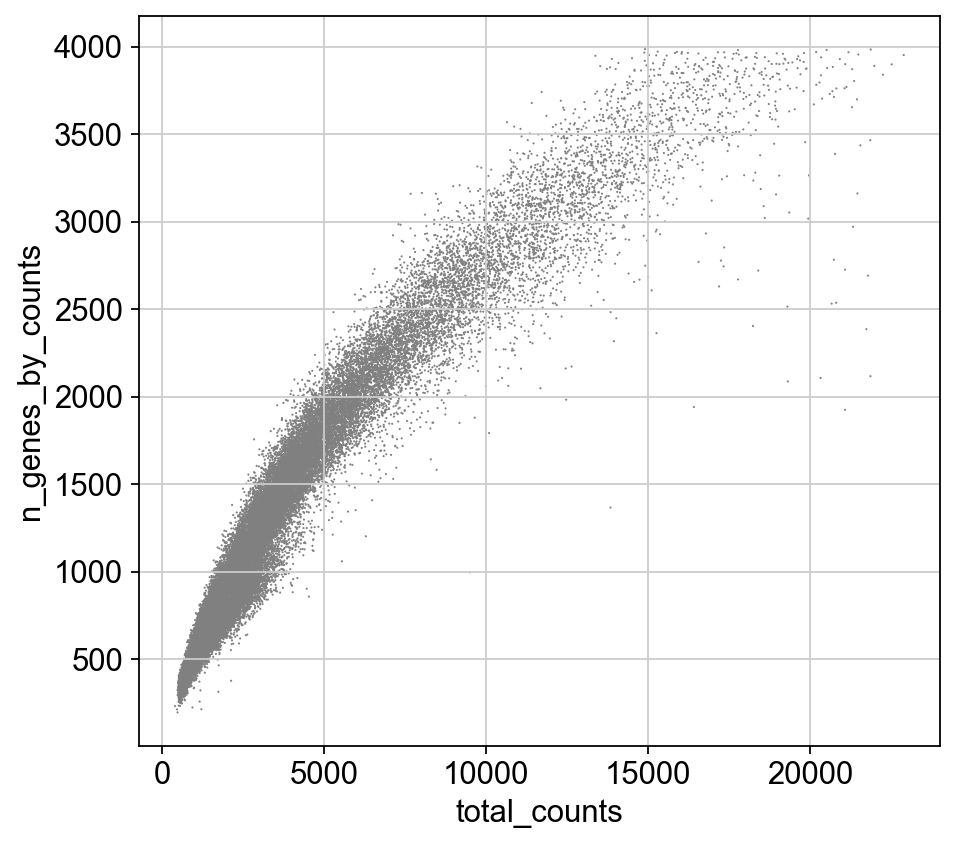

In [7]:
# %% Filtering the data for dead cells

# Identifying mitochondrial genes
adata.var['mt'] = adata.var_names.str.startswith('mt')  # Adjust the prefix if needed

# Identifying ribosomal genes
adata.var['ribo'] = adata.var_names.str.startswith(('Rps', 'Rpl'))  # Adjust these prefixes as needed

# Calculating quality control metrics
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

# Plots for QC
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'], jitter=0.4, multi_panel=True)
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

# Filtering cells based on gene count thresholds
upper_lim = np.quantile(adata.obs.n_genes_by_counts.values, .98)
lower_lim = np.quantile(adata.obs.n_genes_by_counts.values, .02)
adata = adata[(adata.obs.n_genes_by_counts < upper_lim) & (adata.obs.n_genes_by_counts > lower_lim)]

# Filtering cells based on mitochondrial gene percentage
adata = adata[adata.obs.pct_counts_mt < 13, :]

# Removing mitochondrial and ribosomal genes from the dataset
adata = adata[:, ~adata.var['mt'] & ~adata.var['ribo']]

In [8]:
# %% Check for ribosomal genes and mitochondrial genes

ribo_genes = adata.var_names.str.startswith(('Rps', 'Rpl'))
if any(ribo_genes):
    print("Ribosomal genes starting with 'Rps' or 'Rpl' found:")
    print(adata.var_names[ribo_genes])
else:
    print("No ribosomal genes starting with 'Rps' or 'Rpl' found.")

mt_genes = adata.var_names.str.startswith('mt-')
if any(mt_genes):
    print("Mitochondrial genes starting with 'mt-' found:")
    print(adata.var_names[mt_genes])
else:
    print("No mitochondrial genes starting with 'mt-' found.")

No ribosomal genes starting with 'Rps' or 'Rpl' found.
No mitochondrial genes starting with 'mt-' found.


In [9]:
# %% Check if the values are raw counts and MAKE A COPY of RAW counts

from scipy.sparse import issparse

# Check if the data is stored as a sparse matrix
if issparse(adata.X):
    # Convert to a dense format for viewing
    dense_X = adata.X.toarray()
    print("Adata is sparse-matrix")
else:
    # If it's already a dense format, just assign it
    dense_X = adata.X

print(dense_X[:5, :5])

adata.layers["counts"] = adata.X.copy()

adata.raw = adata

Adata is sparse-matrix
[[0. 0. 0. 0. 2.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 0.]
 [1. 0. 0. 1. 2.]
 [1. 2. 0. 0. 0.]]


/tmp/ipykernel_60069/2971283445.py:16: ImplicitModificationWarning: Setting element `.layers['counts']` of view, initializing view as actual.
  adata.layers["counts"] = adata.X.copy()


normalizing counts per cell
    finished (0:00:00)


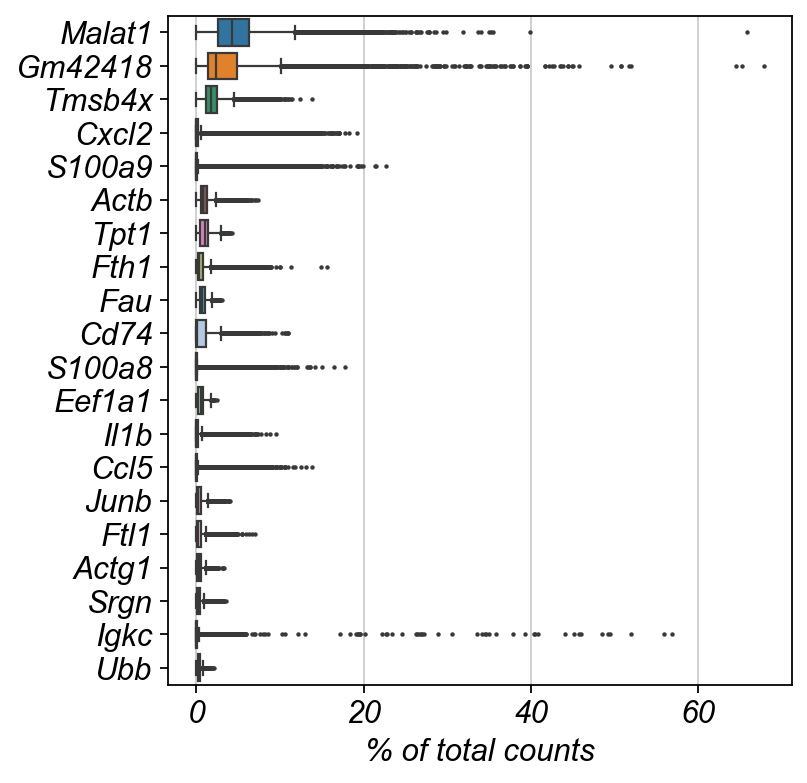

In [10]:
# Set matplotlib's global font settings to italic for all text
plt.rcParams['font.style'] = 'italic'

# Now, generate your plot; all text including gene names should be in italic
sc.pl.highest_expr_genes(adata, n_top=20)

# If you want to reset the font style back to normal for subsequent plots, do the following:
plt.rcParams['font.style'] = 'normal'

In [11]:
# %% Data normalization

sc.pp.normalize_total(adata, target_sum=1e4)

sc.pp.log1p(adata)

sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

adata = adata[:, adata.var.highly_variable]

sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])


normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
regressing out ['total_counts', 'pct_counts_mt']


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]


    sparse input is densified and may lead to high memory use
    finished (0:01:07)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:05)


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


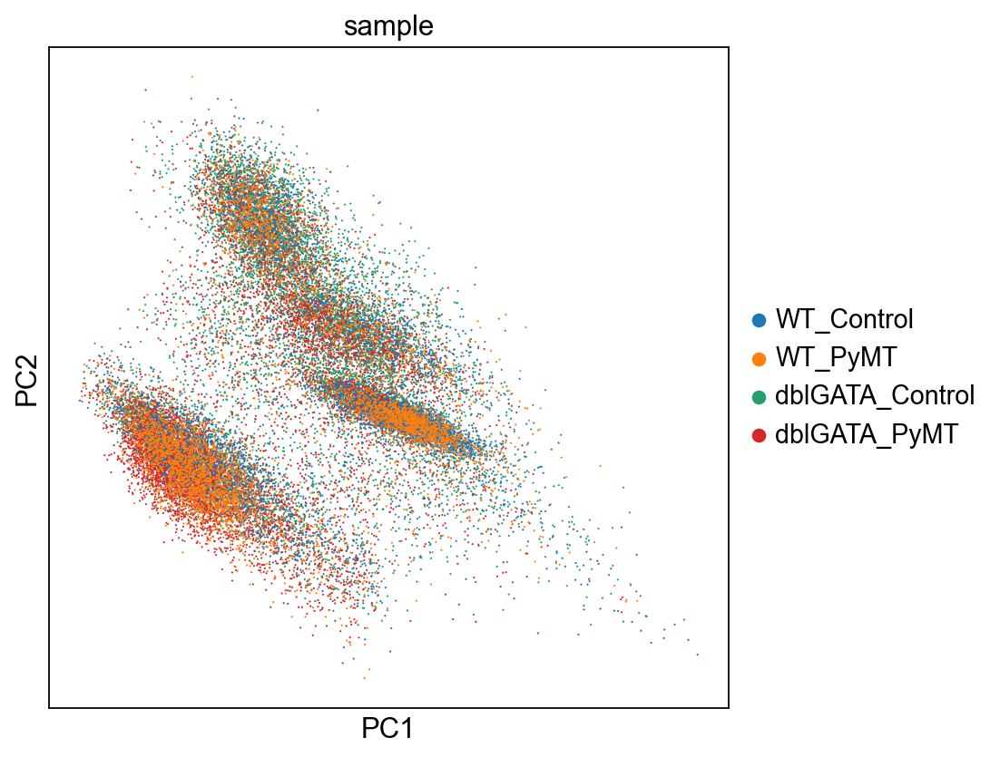

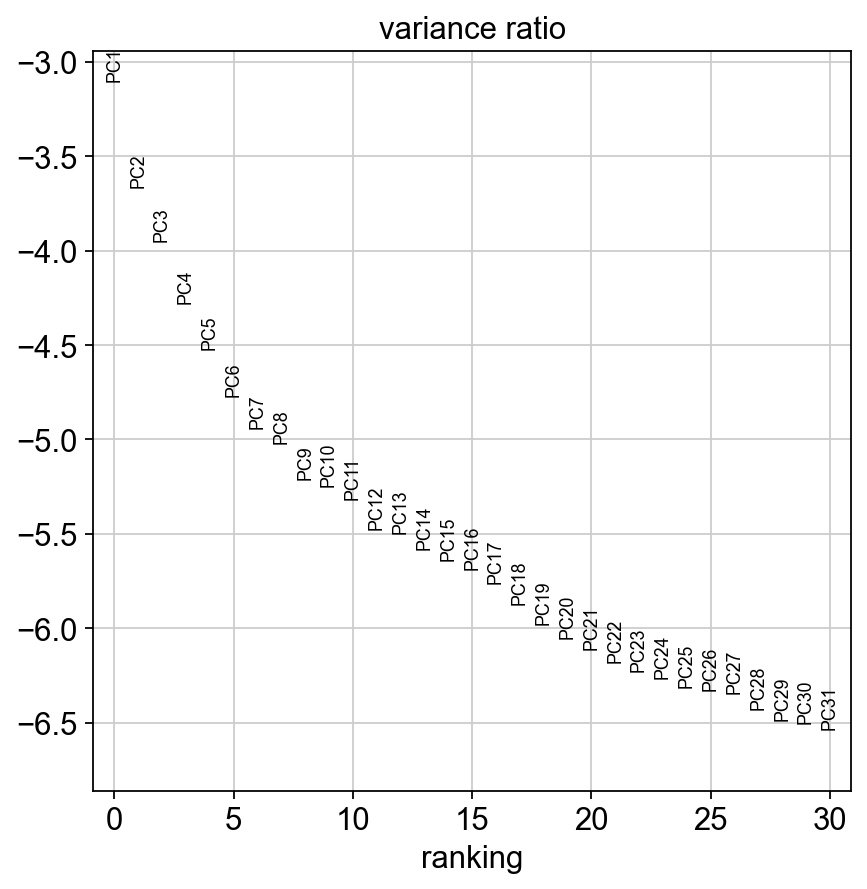

In [12]:
# %% Scaling data

sc.pp.scale(adata, max_value=10)

sc.tl.pca(adata, svd_solver='arpack')

sc.pl.pca(adata, color='sample')

sc.pl.pca_variance_ratio(adata, log=True)


[[-0.46532783 -0.05409187 -0.09480531 -0.08358791 -0.07920375]
 [ 2.4161005  -0.13208336 -0.12292007 -0.06362134 -0.04640765]
 [-0.4596111  -0.07889665 -0.11126979 -0.06999224 -0.06864309]
 [ 1.4446405   0.06248839 -0.06446001 -0.10218403 -0.12802488]
 [-0.48129487  0.04294431 -0.02703766 -0.14000902 -0.12057508]]
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:19)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


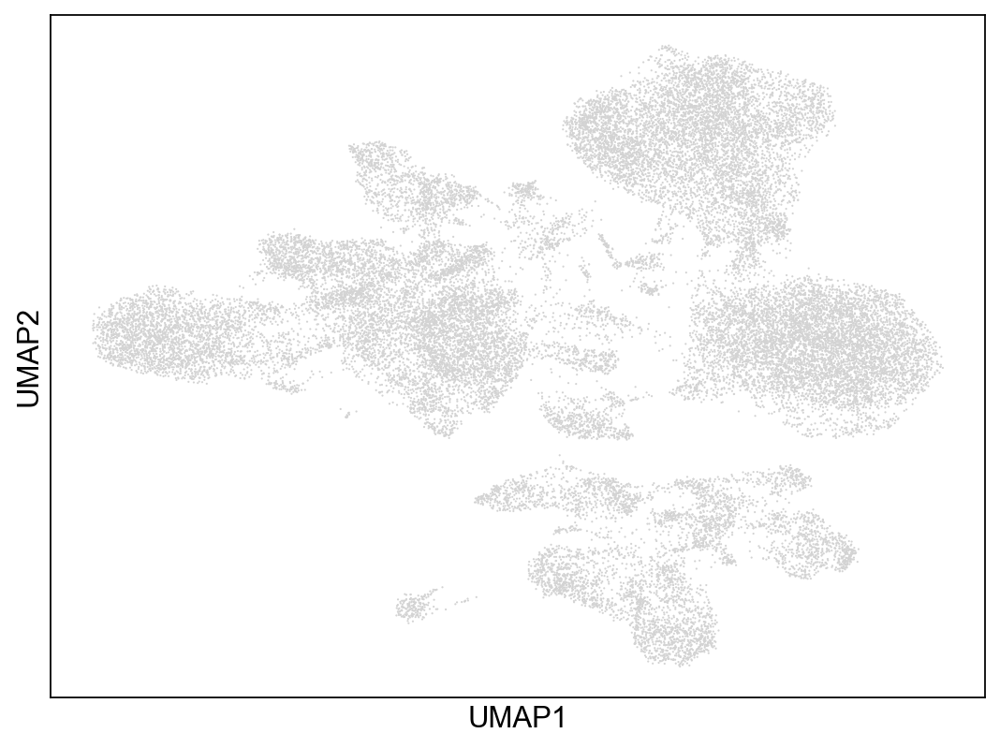

running Leiden clustering
    finished: found 14 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:08)


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


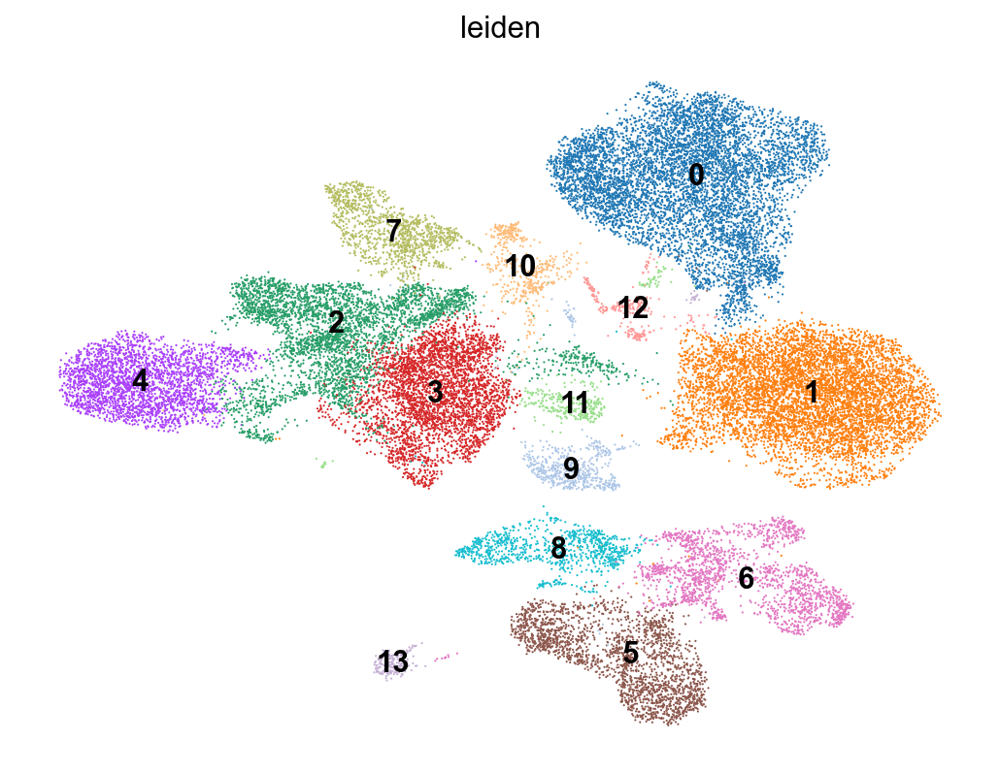

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


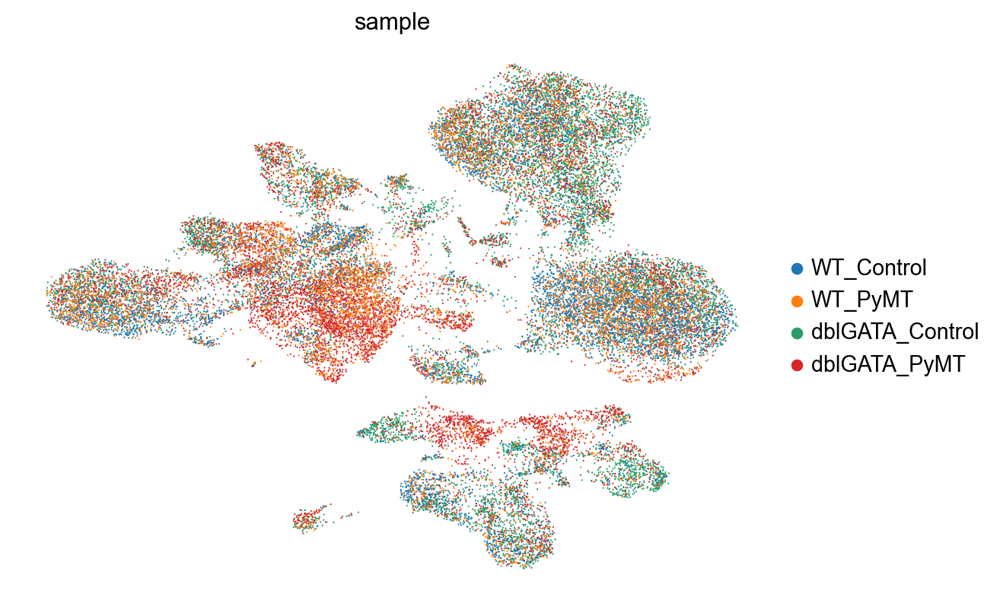

ranking genes


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:26)
running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


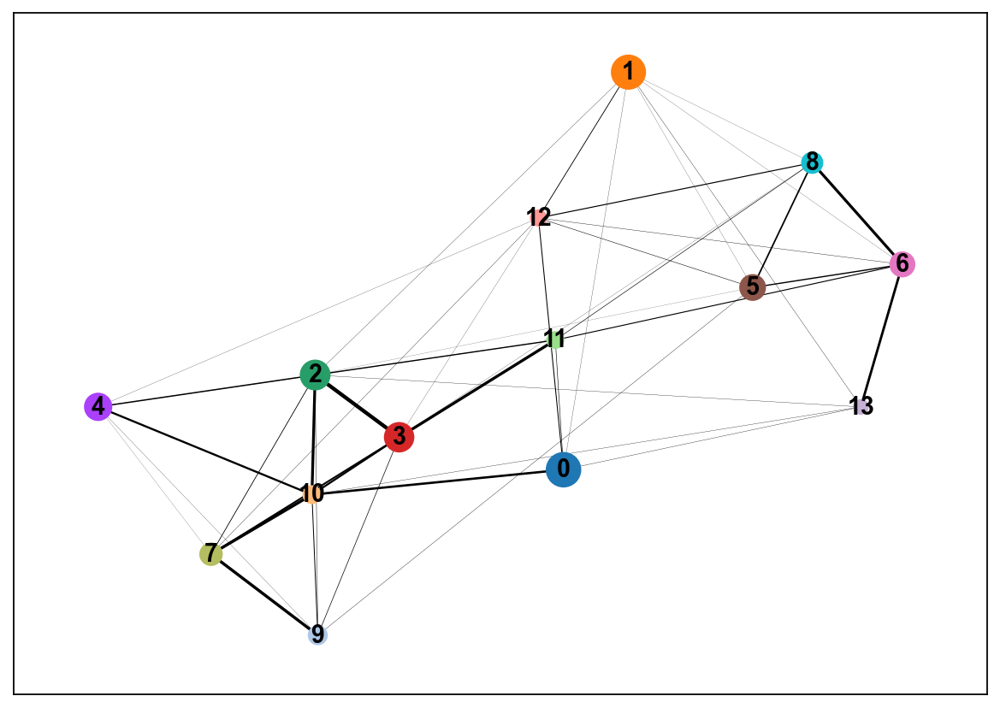

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:14)


In [13]:
# %% Plotting UMAP

sc.set_figure_params(figsize=(8, 6))

print(adata.X[:5, :5])

sc.pp.neighbors(adata, n_neighbors=10, n_pcs=30)

sc.tl.umap(adata)

sc.pl.umap(adata)

sc.tl.leiden(adata, resolution=0.3)
sc.pl.umap(adata, color=['leiden'], frameon=False, legend_loc='on data')
sc.pl.umap(adata, color=['sample'], frameon=False, legend_loc='right margin')

sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')

sc.tl.paga(adata)
sc.pl.paga(adata)  
sc.tl.umap(adata, init_pos='paga')

# sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

#sc.tl.tsne(adata)
#sc.pl.tsne(adata, color=['leiden'], frameon=False, legend_loc='on data')


In [14]:
# %% Save TOP ranked genes
top_n_genes = 25

TOP_genes_cluster = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(top_n_genes)

TOP_genes_cluster.to_csv('/home/liza/Documents/PhD/scRNAseq_Inbal/TOPMarkers.csv', sep=',', encoding='utf-8',
                         header='true', index=False)


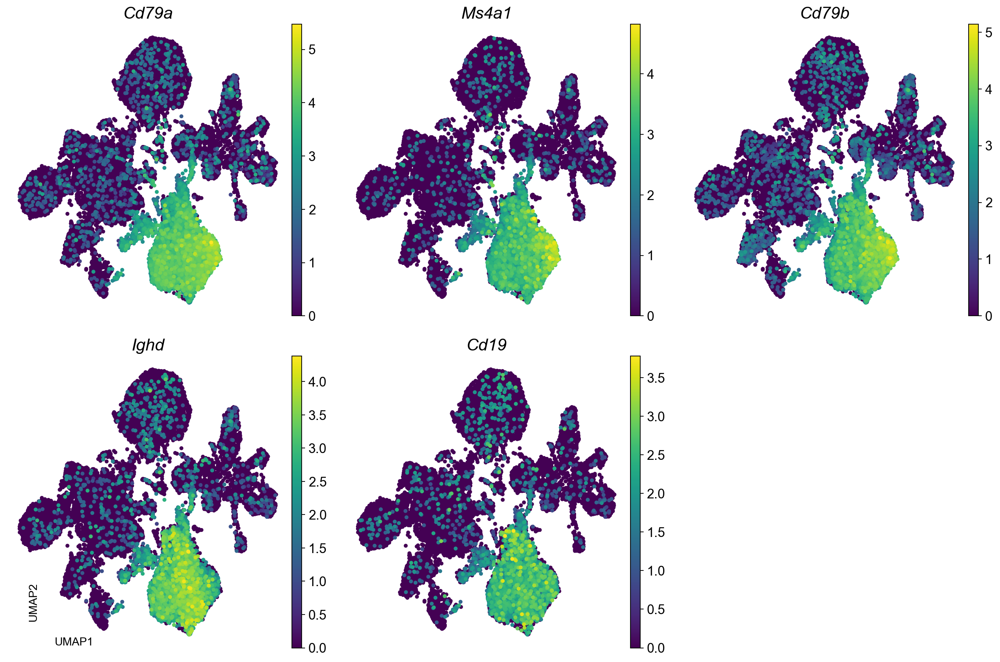

In [20]:
# %% B-cells - 0 - 1 plot

# List of genes to use for coloring
genes = ['Cd79a', 'Ms4a1', 'Cd79b', 'Ighd', 'Cd19']

# Calculate the number of subplot rows and columns needed
n = len(genes)
ncols = 3  # Suggested number of columns
nrows = (n + ncols - 1) // ncols  # Calculate the number of rows needed

# Define your colormap
cmap = 'viridis'  # Or any colormap you prefer


# Create the figure and axes for the subplots
fig, axs = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))

# Flatten the axes array for easier handling
axs = axs.flatten()

# Iterate over the genes and plot each UMAP
for i, gene in enumerate(genes):
    ax = axs[i]
    sc.pl.umap(adata, color=gene, ax=ax, show=False, title=gene, size=70, frameon=False, cmap=cmap)
    # Make the title italic
    ax.set_title(gene, fontstyle='italic', fontsize=18)

# Hide any unused axes
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Adjust the layout for better spacing
plt.tight_layout()

# Add a single set of axis labels for the entire figure
fig.text(0.08, 0.04, 'UMAP1', ha='center', va='center', fontsize=12)  # X-axis label
fig.text(0.04, 0.1, 'UMAP2', ha='center', va='center', rotation='vertical', fontsize=12)  # Y-axis label


# Save the figure as a TIFF file
plt.savefig(f'/home/liza/Documents/PhD/scRNAseq_Inbal/Adata_plots/B_umap.tiff', format='tiff', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

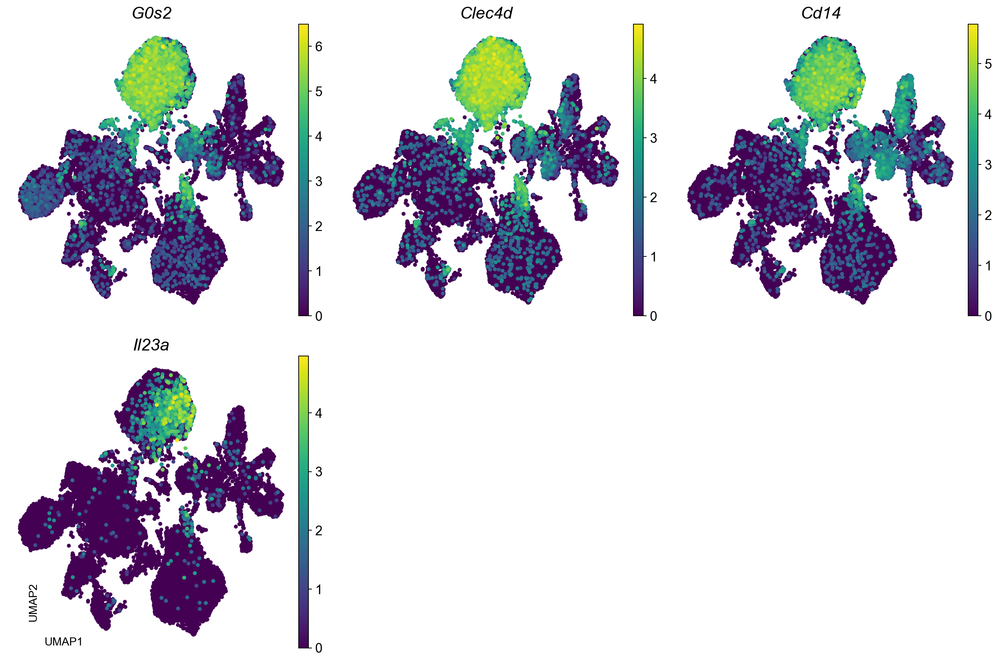

In [21]:
# %% Neutrophils - 1

# List of genes to use for coloring
genes = ['G0s2', 'Clec4d', 'Cd14', 'Il23a']

# Calculate the number of subplot rows and columns needed
n = len(genes)
ncols = 3  # Suggested number of columns
nrows = (n + ncols - 1) // ncols  # Calculate the number of rows needed

# Create the figure and axes for the subplots
fig, axs = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))

# Flatten the axes array for easier handling
axs = axs.flatten()

# Iterate over the genes and plot each UMAP
for i, gene in enumerate(genes):
    ax = axs[i]
    sc.pl.umap(adata, color=gene, ax=ax, show=False, title=gene, size=70, frameon=False)
    # Make the title italic
    ax.set_title(gene, fontstyle='italic', fontsize=18)

# Hide any unused axes
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Adjust the layout for better spacing
plt.tight_layout()

# Add a single set of axis labels for the entire figure
fig.text(0.07, 0.04, 'UMAP1', ha='center', va='center', fontsize=12)  # X-axis label
fig.text(0.04, 0.1, 'UMAP2', ha='center', va='center', rotation='vertical', fontsize=12)  # Y-axis label


# Save the figure as a TIFF file
plt.savefig(f'/home/liza/Documents/PhD/scRNAseq_Inbal/Adata_plots/Neut_umap.tiff', format='tiff', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

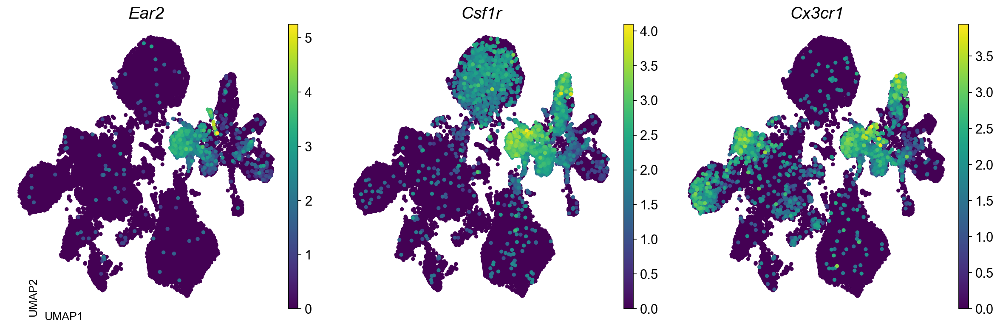

In [19]:
# %% Alveolar macrophage - 5

# List of genes to use for coloring
genes = ['Ear2', 'Csf1r', 'Cx3cr1']

# Calculate the number of subplot rows and columns needed
n = len(genes)
ncols = 3  # Suggested number of columns
nrows = (n + ncols - 1) // ncols  # Calculate the number of rows needed

# Create the figure and axes for the subplots
fig, axs = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))

# Flatten the axes array for easier handling
axs = axs.flatten()

# Iterate over the genes and plot each UMAP
for i, gene in enumerate(genes):
    ax = axs[i]
    sc.pl.umap(adata, color=gene, ax=ax, show=False, title=gene, size=70, frameon=False)
    # Make the title italic
    ax.set_title(gene, fontstyle='italic', fontsize=18)

# Hide any unused axes
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Adjust the layout for better spacing
plt.tight_layout()

# Add a single set of axis labels for the entire figure
fig.text(0.07, 0.04, 'UMAP1', ha='center', va='center', fontsize=12)  # X-axis label
fig.text(0.04, 0.1, 'UMAP2', ha='center', va='center', rotation='vertical', fontsize=12)  # Y-axis label


# Save the figure as a TIFF file
plt.savefig(f'/home/liza/Documents/PhD/scRNAseq_Inbal/Adata_plots/AM_umap.tiff', format='tiff', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()


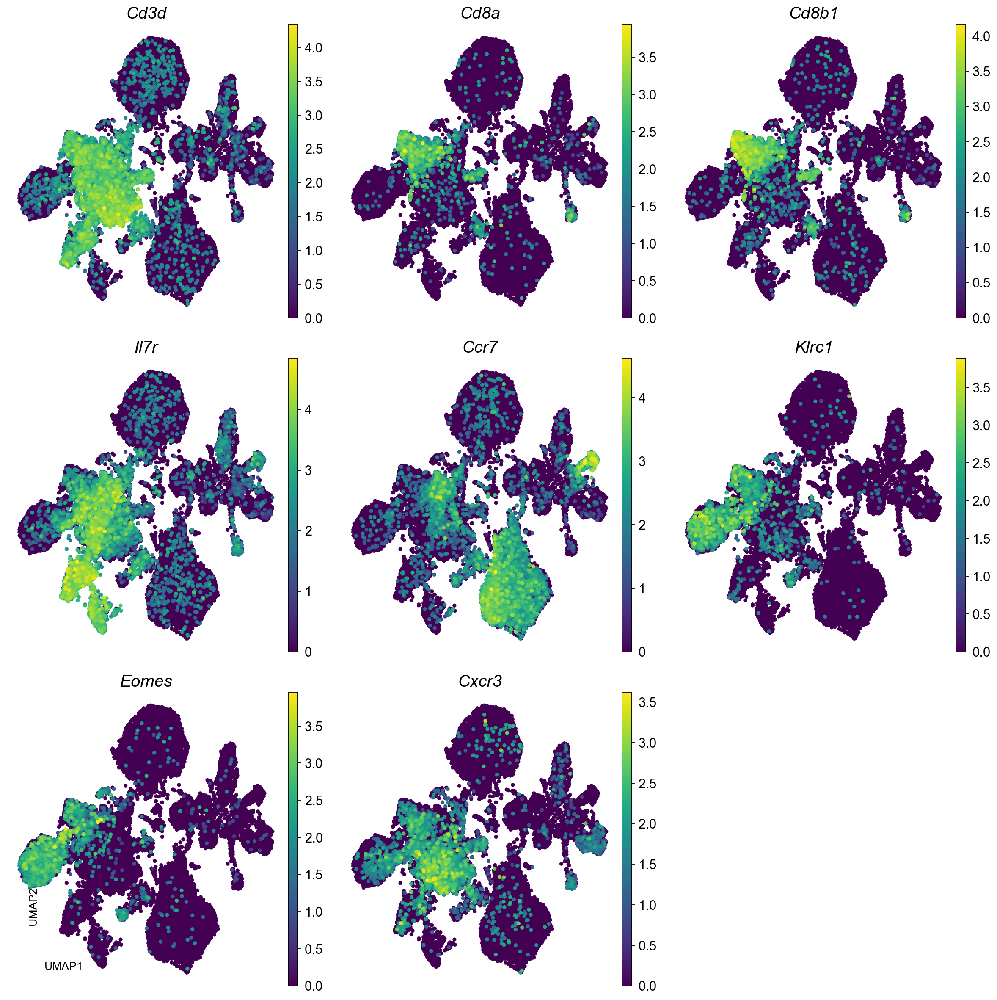

In [20]:
# %% CD8+ T-cell - 2

# List of genes to use for coloring
genes = ['Cd3d', 'Cd8a', 'Cd8b1', 'Il7r', 'Ccr7', 'Klrc1', 'Eomes', 'Cxcr3']

# Calculate the number of subplot rows and columns needed
n = len(genes)
ncols = 3  # Suggested number of columns
nrows = (n + ncols - 1) // ncols  # Calculate the number of rows needed

# Create the figure and axes for the subplots
fig, axs = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))

# Flatten the axes array for easier handling
axs = axs.flatten()

# Iterate over the genes and plot each UMAP
for i, gene in enumerate(genes):
    ax = axs[i]
    sc.pl.umap(adata, color=gene, ax=ax, show=False, title=gene, size=70, frameon=False)
    # Make the title italic
    ax.set_title(gene, fontstyle='italic', fontsize=18)

# Hide any unused axes
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Adjust the layout for better spacing
plt.tight_layout()

# Add a single set of axis labels for the entire figure
fig.text(0.07, 0.04, 'UMAP1', ha='center', va='center', fontsize=12)  # X-axis label
fig.text(0.04, 0.1, 'UMAP2', ha='center', va='center', rotation='vertical', fontsize=12)  # Y-axis label


# Save the figure as a TIFF file
plt.savefig(f'/home/liza/Documents/PhD/scRNAseq_Inbal/Adata_plots/CD8_umap.tiff', format='tiff', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()



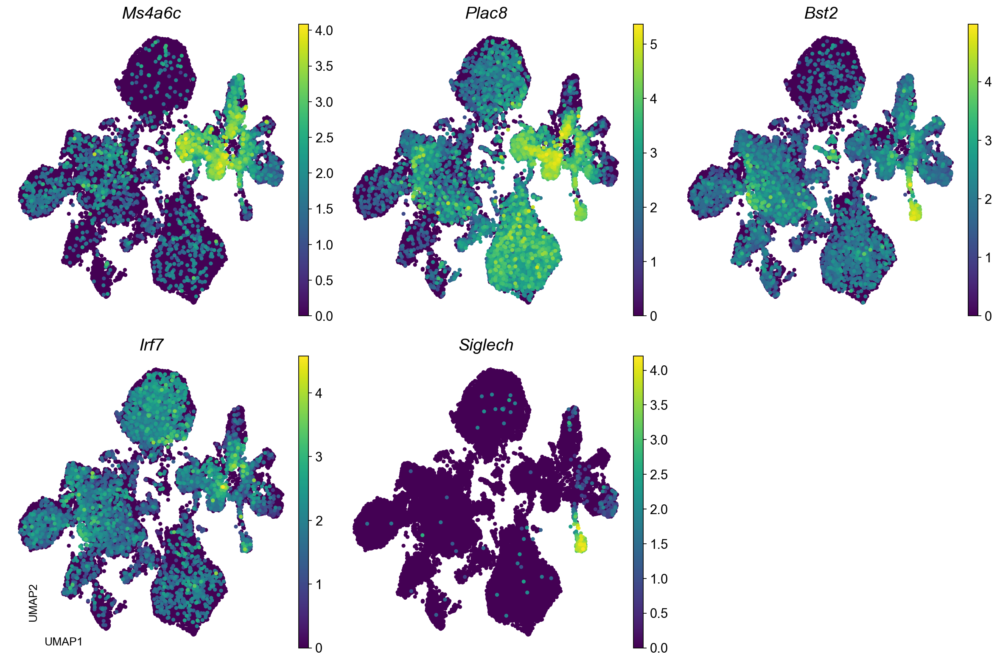

In [21]:
# %% Plasmacytoid dendritic cell - 13

# List of genes to use for coloring
genes = ['Ms4a6c', 'Plac8', 'Bst2', 'Irf7', 'Siglech']

# Calculate the number of subplot rows and columns needed
n = len(genes)
ncols = 3  # Suggested number of columns
nrows = (n + ncols - 1) // ncols  # Calculate the number of rows needed

# Create the figure and axes for the subplots
fig, axs = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))

# Flatten the axes array for easier handling
axs = axs.flatten()

# Iterate over the genes and plot each UMAP
for i, gene in enumerate(genes):
    ax = axs[i]
    sc.pl.umap(adata, color=gene, ax=ax, show=False, title=gene, size=70, frameon=False)
    # Make the title italic
    ax.set_title(gene, fontstyle='italic', fontsize=18)

# Hide any unused axes
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Adjust the layout for better spacing
plt.tight_layout()

# Add a single set of axis labels for the entire figure
fig.text(0.07, 0.04, 'UMAP1', ha='center', va='center', fontsize=12)  # X-axis label
fig.text(0.04, 0.1, 'UMAP2', ha='center', va='center', rotation='vertical', fontsize=12)  # Y-axis label


# Save the figure as a TIFF file
plt.savefig(f'/home/liza/Documents/PhD/scRNAseq_Inbal/Adata_plots/pDc_umap.tiff', format='tiff', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()



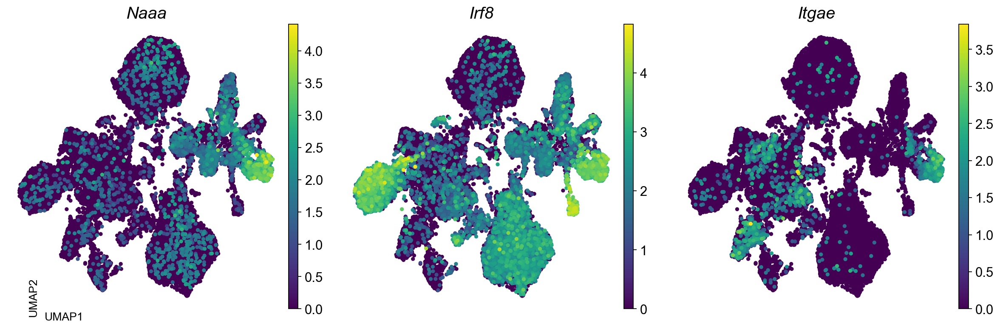

In [22]:
# %% Dendritic -  6

# List of genes to use for coloring
genes = ['Naaa', 'Irf8', 'Itgae']

# Calculate the number of subplot rows and columns needed
n = len(genes)
ncols = 3  # Suggested number of columns
nrows = (n + ncols - 1) // ncols  # Calculate the number of rows needed

# Create the figure and axes for the subplots
fig, axs = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))

# Flatten the axes array for easier handling
axs = axs.flatten()

# Iterate over the genes and plot each UMAP
for i, gene in enumerate(genes):
    ax = axs[i]
    sc.pl.umap(adata, color=gene, ax=ax, show=False, title=gene, size=70, frameon=False)
    # Make the title italic
    ax.set_title(gene, fontstyle='italic', fontsize=18)

# Hide any unused axes
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Adjust the layout for better spacing
plt.tight_layout()

# Add a single set of axis labels for the entire figure
fig.text(0.07, 0.04, 'UMAP1', ha='center', va='center', fontsize=12)  # X-axis label
fig.text(0.04, 0.1, 'UMAP2', ha='center', va='center', rotation='vertical', fontsize=12)  # Y-axis label


# Save the figure as a TIFF file
plt.savefig(f'/home/liza/Documents/PhD/scRNAseq_Inbal/Adata_plots/Dc_umap.tiff', format='tiff', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()


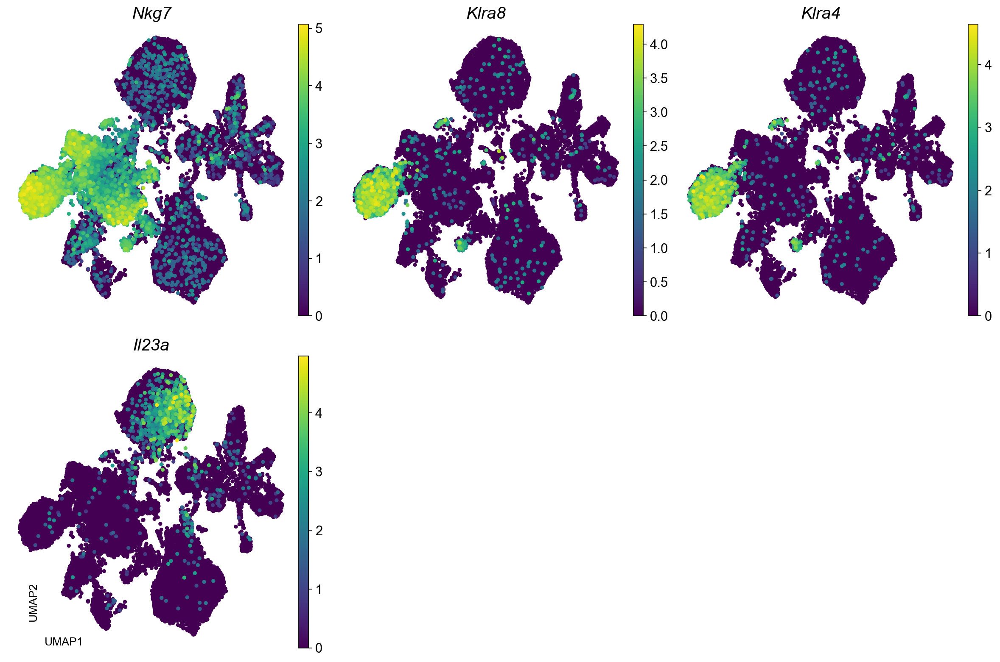

In [23]:
# %% NK Cell - 3

# List of genes to use for coloring
genes = ['Nkg7', 'Klra8', 'Klra4', 'Il23a']

# Calculate the number of subplot rows and columns needed
n = len(genes)
ncols = 3  # Suggested number of columns
nrows = (n + ncols - 1) // ncols  # Calculate the number of rows needed

# Create the figure and axes for the subplots
fig, axs = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))

# Flatten the axes array for easier handling
axs = axs.flatten()

# Iterate over the genes and plot each UMAP
for i, gene in enumerate(genes):
    ax = axs[i]
    sc.pl.umap(adata, color=gene, ax=ax, show=False, title=gene, size=70, frameon=False)
    # Make the title italic
    ax.set_title(gene, fontstyle='italic', fontsize=18)

# Hide any unused axes
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Adjust the layout for better spacing
plt.tight_layout()

# Add a single set of axis labels for the entire figure
fig.text(0.07, 0.04, 'UMAP1', ha='center', va='center', fontsize=12)  # X-axis label
fig.text(0.04, 0.1, 'UMAP2', ha='center', va='center', rotation='vertical', fontsize=12)  # Y-axis label


# Save the figure as a TIFF file
plt.savefig(f'/home/liza/Documents/PhD/scRNAseq_Inbal/Adata_plots/NK_umap.tiff', format='tiff', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

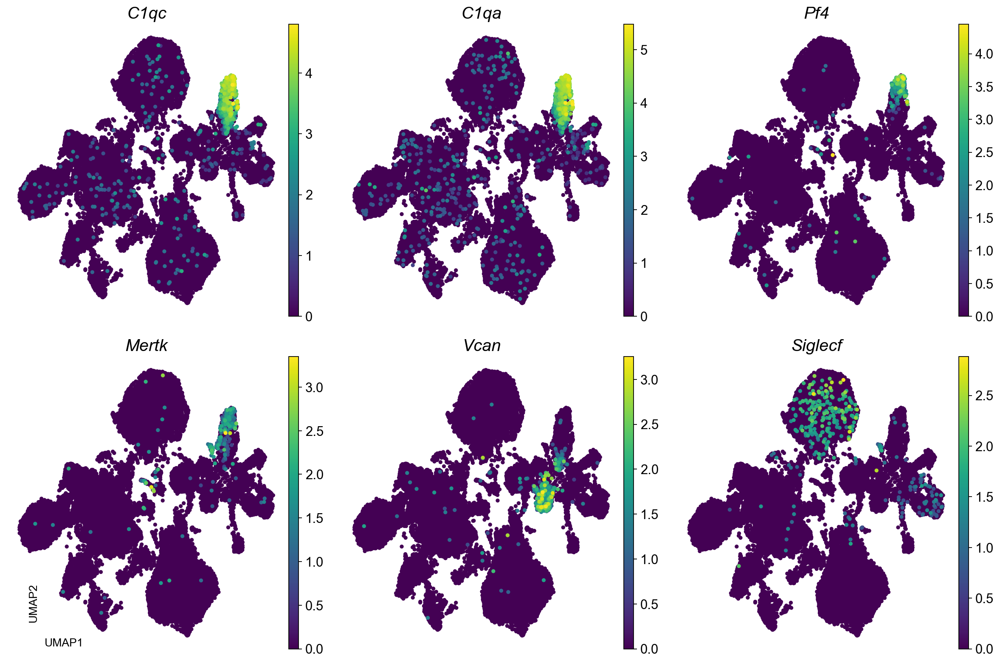

In [42]:
# %% Interstitial macrophage - 8

# List of genes to use for coloring
genes = ['C1qc', 'C1qa', 'Pf4', 'Mertk', 'Vcan']

# Calculate the number of subplot rows and columns needed
n = len(genes)
ncols = 3  # Suggested number of columns
nrows = (n + ncols - 1) // ncols  # Calculate the number of rows needed

# Create the figure and axes for the subplots
fig, axs = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))

# Flatten the axes array for easier handling
axs = axs.flatten()

# Iterate over the genes and plot each UMAP
for i, gene in enumerate(genes):
    ax = axs[i]
    sc.pl.umap(adata, color=gene, ax=ax, show=False, title=gene, size=70, frameon=False)
    # Make the title italic
    ax.set_title(gene, fontstyle='italic', fontsize=18)

# Hide any unused axes
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Adjust the layout for better spacing
plt.tight_layout()

# Add a single set of axis labels for the entire figure
fig.text(0.07, 0.04, 'UMAP1', ha='center', va='center', fontsize=12)  # X-axis label
fig.text(0.04, 0.1, 'UMAP2', ha='center', va='center', rotation='vertical', fontsize=12)  # Y-axis label


# Save the figure as a TIFF file
plt.savefig(f'/home/liza/Documents/PhD/scRNAseq_Inbal/Adata_plots/IM_umap.tiff', format='tiff', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

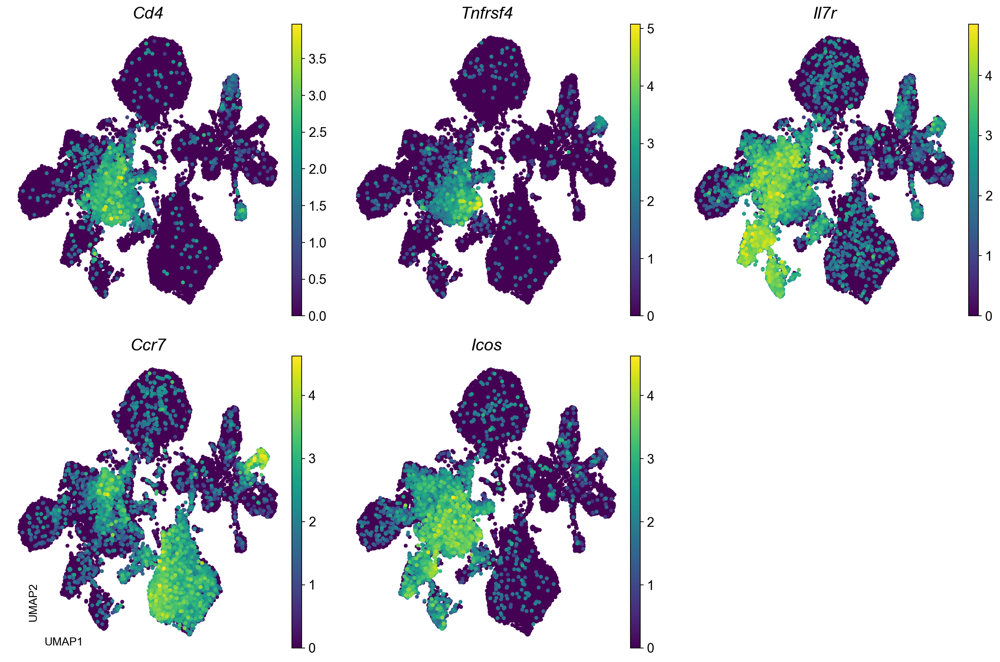

In [25]:
# %% CD4+ T-cells - 2

# List of genes to use for coloring
genes = ['Cd4', 'Tnfrsf4', 'Il7r', 'Ccr7', 'Icos']

# Calculate the number of subplot rows and columns needed
n = len(genes)
ncols = 3  # Suggested number of columns
nrows = (n + ncols - 1) // ncols  # Calculate the number of rows needed

# Create the figure and axes for the subplots
fig, axs = plt.subplots(nrows, ncols, figsize=(5*ncols, 5*nrows))

# Flatten the axes array for easier handling
axs = axs.flatten()

# Iterate over the genes and plot each UMAP
for i, gene in enumerate(genes):
    ax = axs[i]
    sc.pl.umap(adata, color=gene, ax=ax, show=False, title=gene, size=70, frameon=False)
    # Make the title italic
    ax.set_title(gene, fontstyle='italic', fontsize=18)

# Hide any unused axes
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Adjust the layout for better spacing
plt.tight_layout()

# Add a single set of axis labels for the entire figure
fig.text(0.07, 0.04, 'UMAP1', ha='center', va='center', fontsize=12)  # X-axis label
fig.text(0.04, 0.1, 'UMAP2', ha='center', va='center', rotation='vertical', fontsize=12)  # Y-axis label


# Save the figure as a TIFF file
plt.savefig(f'/home/liza/Documents/PhD/scRNAseq_Inbal/Adata_plots/CD4_umap.tiff', format='tiff', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


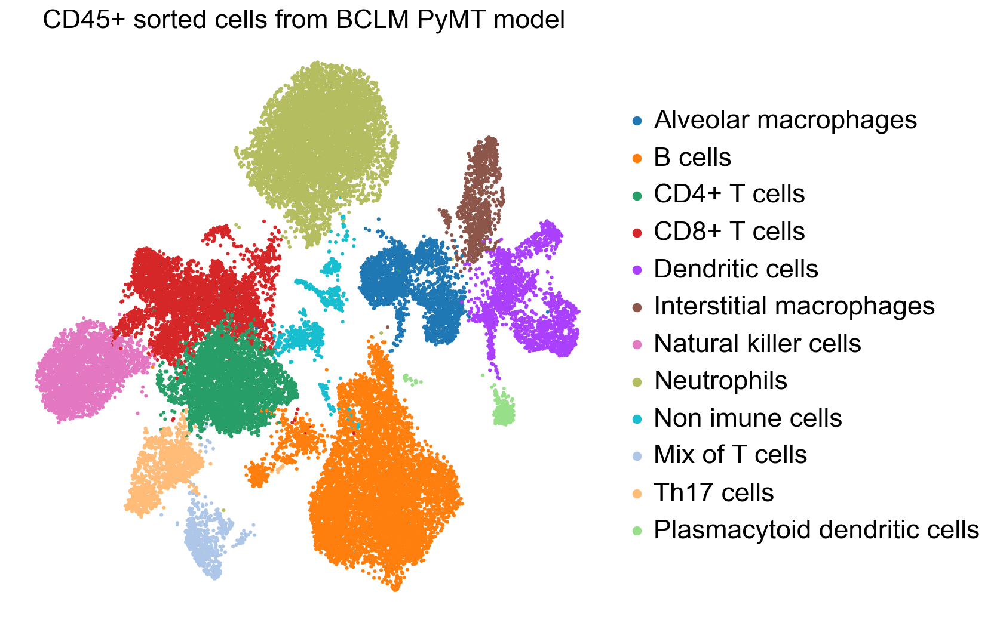

In [16]:
# %% ANNOTATION CELL CLUSTERS

cell_type = {
    '0': "B",
    '1': "Neut",
    '2': "CD8+",
    '3': "CD4+",
    '4': "NK",
    '5': "Alv Macro",
    '6': "Dend",
    '7': "Th17",
    '8': "Inter Macro",
    '9': "T",
    '10': "B",
    '11': "Non_imune",
    '12': "Non_imune",
    '13': "pcDc"
}

adata.obs['cell_type'] = adata.obs['leiden'].map(cell_type)

sc.set_figure_params(figsize=(8, 8))

# Custom cell type names for the legend
custom_legend_labels = {
    'B': "B cells",
    'Neut': "Neutrophils",
    'CD8+': "CD8+ T cells",
    'CD4+': "CD4+ T cells",
    'NK': "Natural killer cells",
    'Alv Macro': "Alveolar macrophages",
    'Dend': "Dendritic cells",
    'Th17': "Th17 cells",
    'Inter Macro': "Interstitial macrophages",
    'T': "Mix of T cells",
    'Non_imune': "Non imune cells",
    'pcDc': "Plasmacytoid dendritic cells"
}

ax = sc.pl.umap(adata, color='cell_type', title='Cell types', frameon=False, size=30, show=False)

# Adjust title font size indirectly (if direct approach as described isn't applicable)
plt.title('CD45+ sorted cells from BCLM PyMT model ', fontsize=20)  # Adjust fontsize as per your requirement

# To adjust the legend font size, you would typically need to get the legend object.
# Since it's not straightforward with Scanpy's plotting, we use matplotlib's global parameter to set legend font size.
plt.rcParams['legend.title_fontsize'] = 'large' # For legend title
plt.rcParams['legend.fontsize'] = 20  # Adjust fontsize as per your requirement

# Manually update legend labels
handles, labels = ax.get_legend_handles_labels()
new_labels = [custom_legend_labels.get(label, label) for label in labels]
ax.legend(handles, new_labels, loc='center left', bbox_to_anchor=(1, 0.5), fontsize=20, title_fontsize='large', frameon=False)

# Save the figure as a TIFF file
plt.savefig(f'/home/liza/Documents/PhD/scRNAseq_Inbal/Adata_plots/Cell_types_UMAP.tiff', format='tiff', dpi=300, bbox_inches='tight')

plt.show()

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'nor

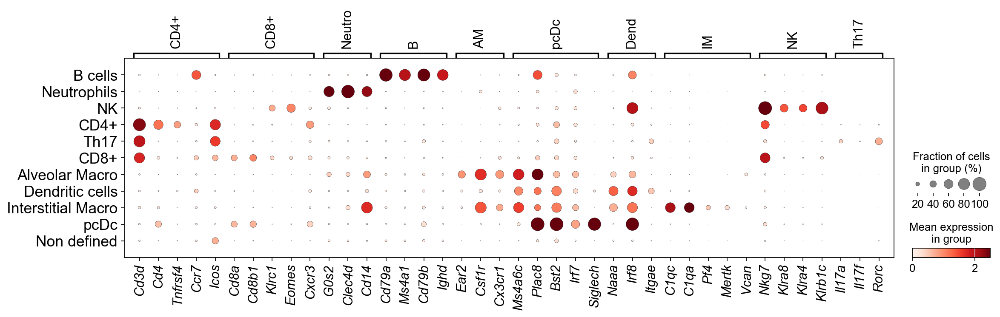

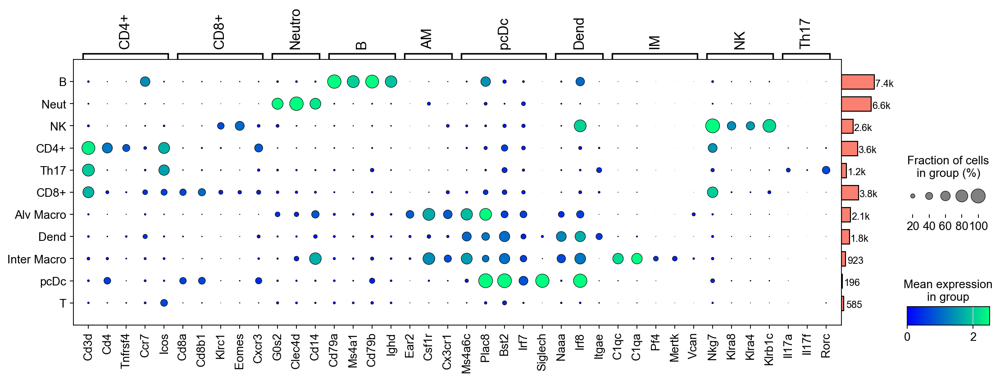

In [17]:
# Dotplot of all CD45+ sorted cells

sc.set_figure_params(figsize=(10, 20))

# Define the desired order for the samples
celltypes_order = ['B', 'Neut', 'NK', 'CD4+', 'Th17', 'CD8+', 'Alv Macro', 'Dend', 'Inter Macro', 'pcDc', 'T']

# Convert the 'sample' column to a categorical type with the specified order
adata.obs['cell_type'] = pd.Categorical(adata.obs['cell_type'], categories=celltypes_order, ordered=True)


# List of marker genes for different T cell states
marker_genes = {
    'CD4+': ['Cd3d', 'Cd4', 'Tnfrsf4', 'Ccr7', 'Icos'],
    'CD8+': ['Cd8a', 'Cd8b1', 'Klrc1', 'Eomes', 'Cxcr3'],
    'Neutro': ['G0s2', 'Clec4d', 'Cd14'],
    'B': ['Cd79a', 'Ms4a1', 'Cd79b', 'Ighd'],
    'AM': ['Ear2', 'Csf1r', 'Cx3cr1'],
    'pcDc': ['Ms4a6c', 'Plac8', 'Bst2', 'Irf7', 'Siglech'],
    'Dend': ['Naaa', 'Irf8', 'Itgae'],
    'IM': ['C1qc', 'C1qa', 'Pf4', 'Mertk', 'Vcan'],
    'NK': ['Nkg7', 'Klra8', 'Klra4', 'Klrb1c'],
    'Th17': ['Il17a', 'Il17f', 'Rorc']
}

# Perform dot plot
dp = sc.pl.dotplot(adata, marker_genes, groupby='cell_type', vmax = 2.5, return_fig=True)

new_ytick_names = ['B cells', 'Neutrophils', 'NK', 'CD4+', 'Th17', 'CD8+', 'Alveolar Macro', 'Dendritic cells', 
                   'Interstitial Macro', 'pcDc', 'Non defined']

# Accessing the axes and modifying x-tick labels
axes_dict = dp.get_axes()
mainplot_ax = axes_dict['mainplot_ax']

for label in mainplot_ax.get_xticklabels():
    label.set_fontstyle('italic')
    label.set_fontsize(14)
for label in mainplot_ax.get_yticklabels():
    label.set_fontsize(14)

mainplot_ax.set_yticklabels(new_ytick_names, fontsize=16)

# Attempt to redraw the figure



# Annotate clusters with their corresponding T cell states

cluster_to_state = {
        '0': 'CD4+',
        '1': 'CD8+',
        '2': 'Th17',
        '3': 'NK',
        '4': 'B',
        '5': 'Neutro',
        '6': 'AM',
        '7': 'IM',
        '8': 'Dend',
        '9': 'pcDc'
    }
# Show the plot
    
dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()

# If plt.draw() does not reflect changes, try explicitly showing the figure again
plt.show()

In [18]:
# %% T-cells cluster

adata_T = adata[
    (adata.obs['cell_type'] == 'CD8+') | (adata.obs['cell_type'] == 'CD4+') | (adata.obs['cell_type'] == 'T') | (adata.obs['cell_type'] == 'Th17')].copy()


computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:44)


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


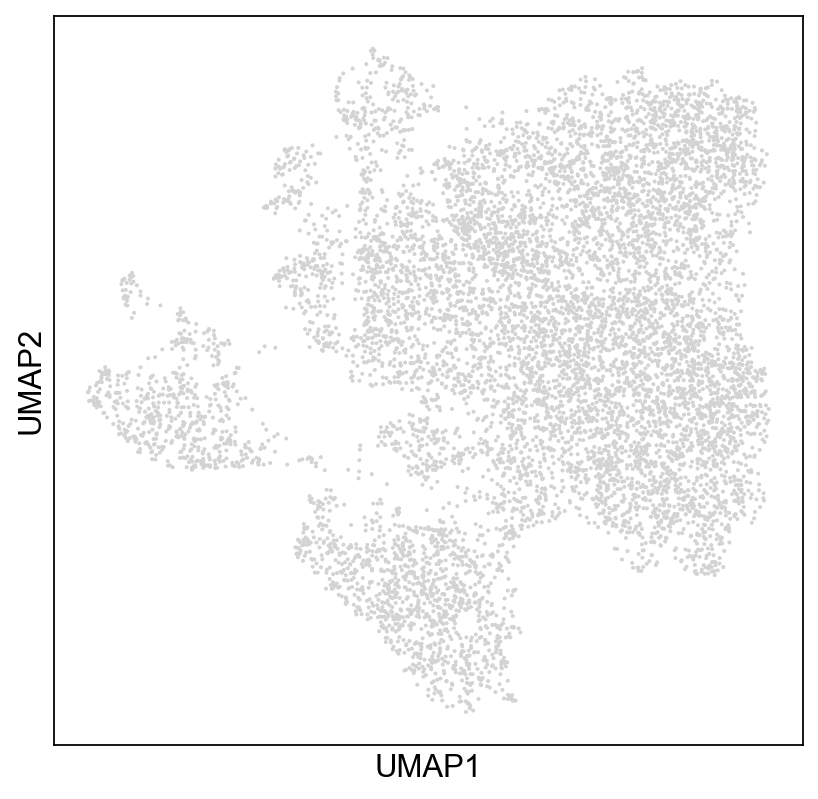

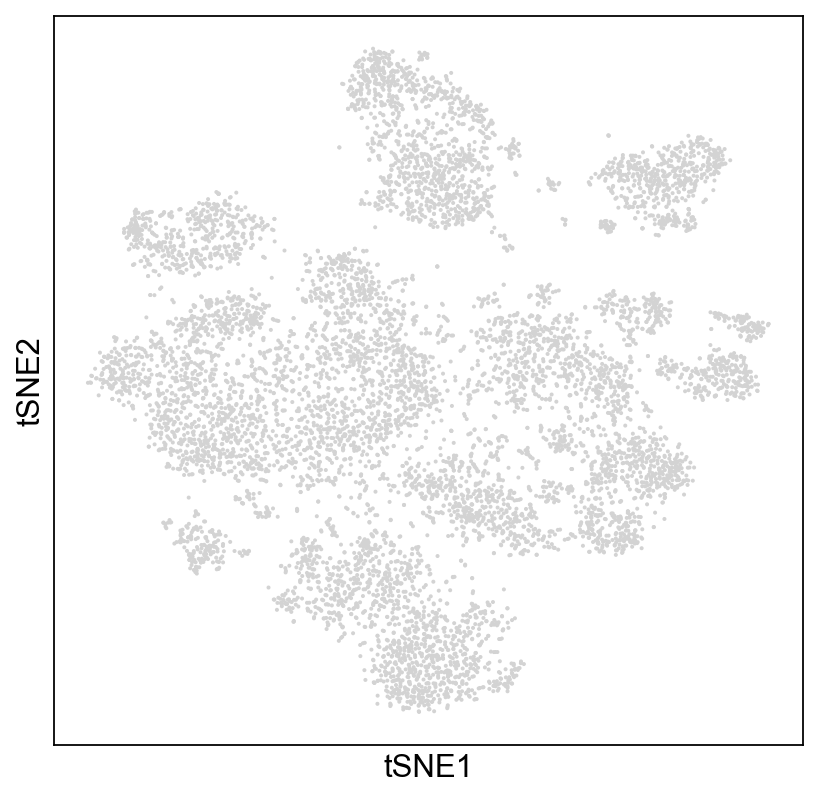

ranking genes


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:11)


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


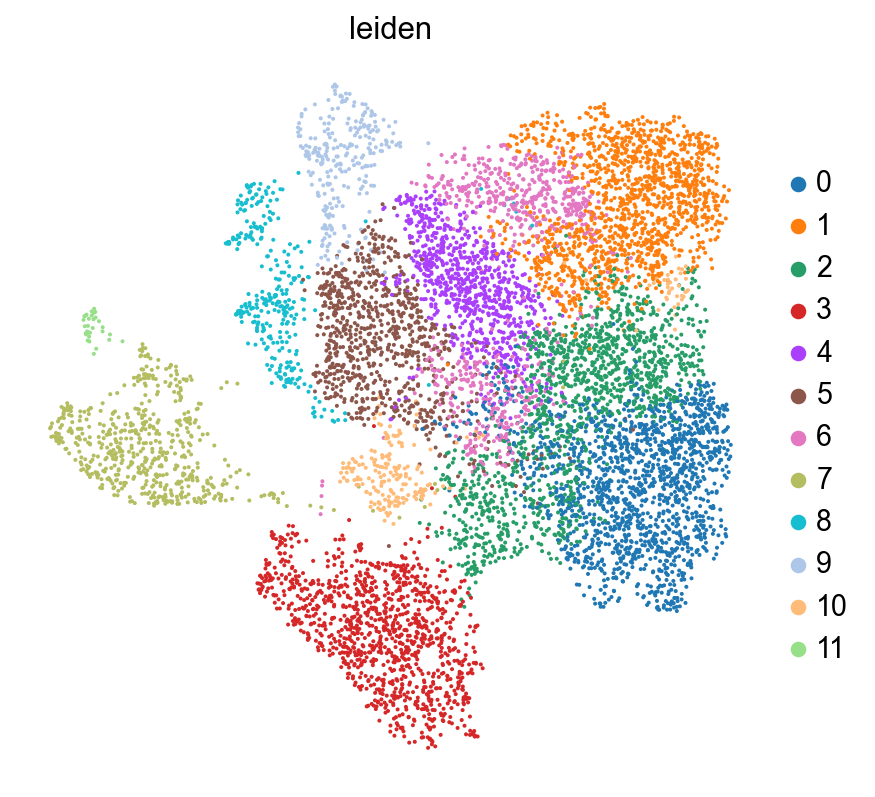

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


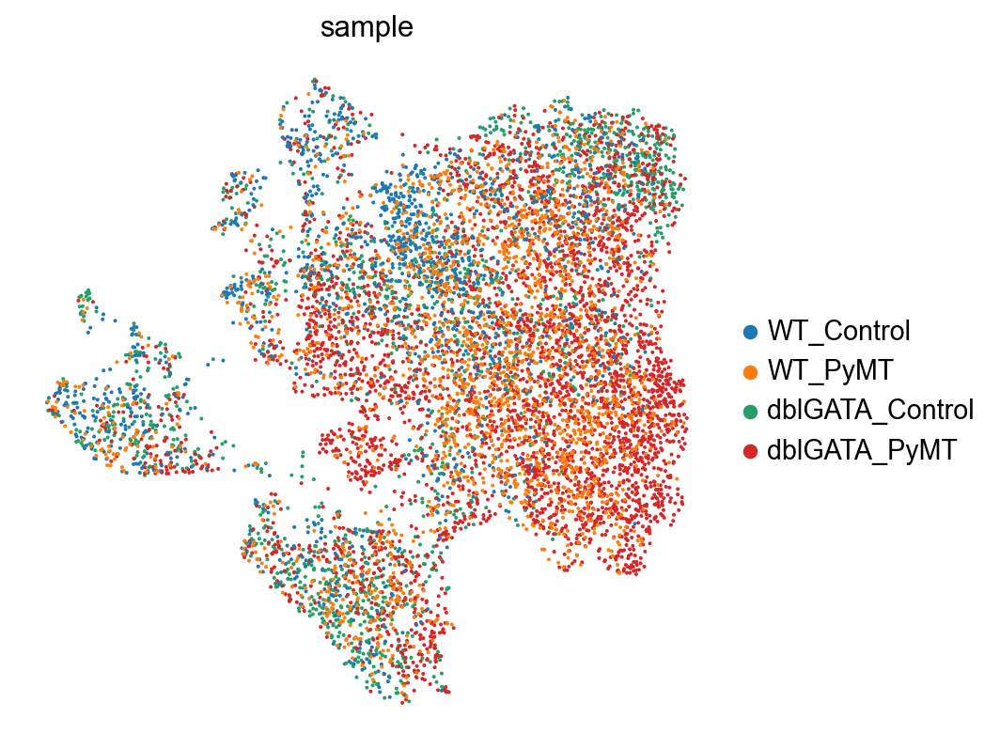

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


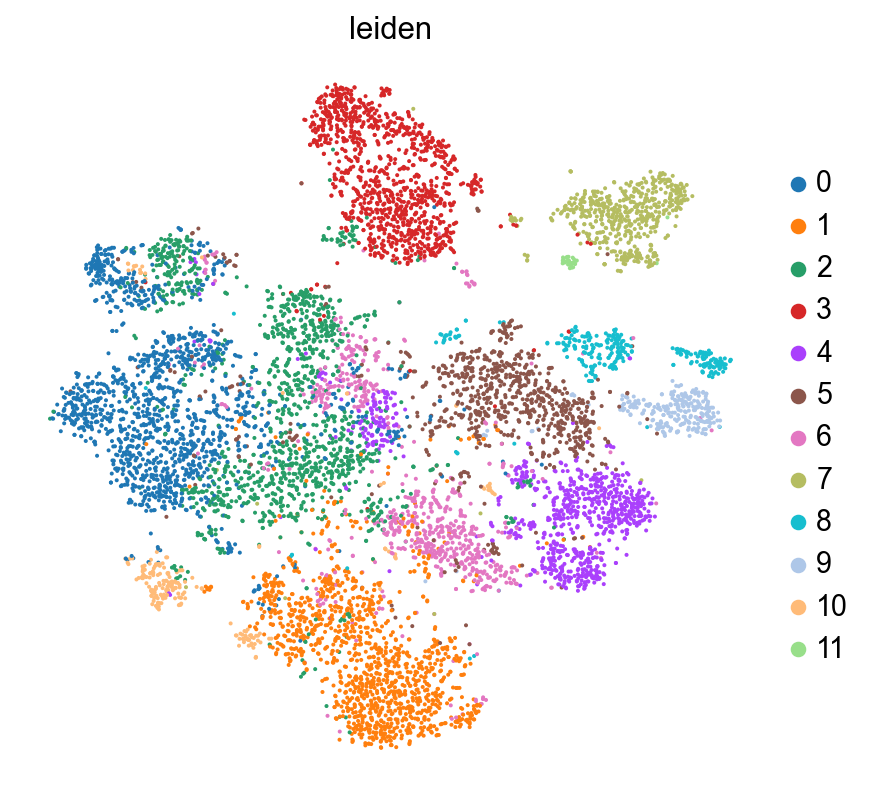

In [19]:
# %% T cluster subcluster

sc.pp.neighbors(adata_T, n_neighbors=5, n_pcs=20)

sc.set_figure_params(figsize=(6, 6))

sc.tl.leiden(adata_T, resolution=0.3)

sc.tl.umap(adata_T)
sc.tl.tsne(adata_T)

sc.pl.umap(adata_T)
sc.pl.tsne(adata_T)

sc.tl.rank_genes_groups(adata_T, 'leiden', method='wilcoxon')

sc.pl.umap(adata_T, color=['leiden'], frameon=False)
sc.pl.umap(adata_T, color=['sample'], frameon=False)

sc.pl.tsne(adata_T, color=['leiden'], frameon=False)


In [20]:
# %% T cells marker genes

marker_genes = pd.DataFrame(adata_T.uns['rank_genes_groups']['names'])

marker_genes.to_csv('/home/liza/Documents/PhD/scRNAseq_Inbal/TOPMarkers_T.csv', sep=',', encoding='utf-8',
                    header='true', index=False)


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'nor

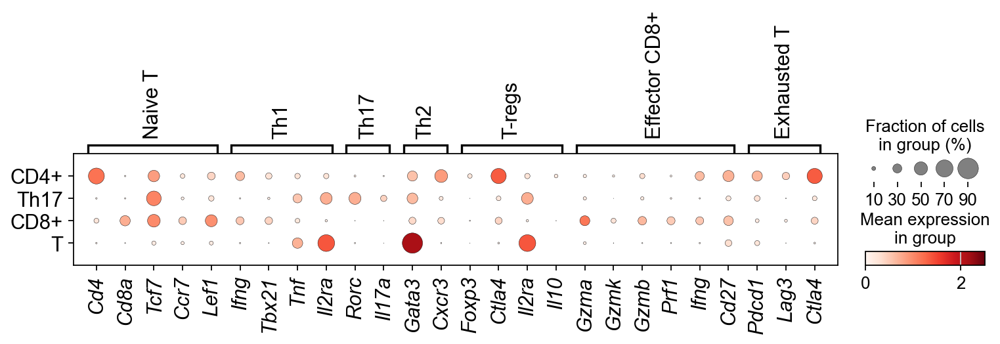

In [22]:
# List of marker genes for different T cell states

marker_genes = {
    'Naive T': ['Cd4', 'Cd8a', 'Tcf7', 'Ccr7', 'Lef1'],
    'Th1': ['Ifng', 'Tbx21', 'Tnf', 'Il2ra'],
    'Th17': ['Rorc', 'Il17a'],
    'Th2': ['Gata3', 'Cxcr3'],
    'T-regs': ['Foxp3', 'Ctla4', 'Il2ra', 'Il10'],
    'Effector CD8+': ['Gzma', 'Gzmk', 'Gzmb', 'Prf1', 'Ifng', 'Cd27'],
    'Exhausted T': ['Pdcd1', 'Lag3', 'Ctla4']
}


# Annotate clusters with their corresponding T cell states
cluster_to_state = {
    '0': 'Naive CD4+ T',
    '1': 'Th1',
    '2': 'Th17',
    '3': 'Th2',
    '4': 'Tregs',
    '5': 'Naive CD8+ T',
    '6': 'Effector CD8+ T',
    '7': 'Memory CD8+ T',
    '8': 'Exhausted T'
}

# Perform dot plot
dp = sc.pl.dotplot(adata_T, marker_genes, groupby='cell_type', vmax = 2.5, return_fig=True)

#new_ytick_names = ['B cells', 'Neutrophils', 'NK', 'CD4+', 'Th17', 'CD8+', 'Alveolar Macro', 'Dendritic cells', 
                   #'Interstitial Macro', 'pcDc', 'Non defined']

# Accessing the axes and modifying x-tick labels
axes_dict = dp.get_axes()
mainplot_ax = axes_dict['mainplot_ax']

for label in mainplot_ax.get_xticklabels():
    label.set_fontstyle('italic')
    label.set_fontsize(14)
for label in mainplot_ax.get_yticklabels():
    label.set_fontsize(14)

#mainplot_ax.set_yticklabels(new_ytick_names, fontsize=16)

plt.savefig('/home/liza/Documents/PhD/scRNAseq_Inbal/dotplot_adata_T.tiff', format='tiff', dpi=300, bbox_inches='tight')

# Show the plot
plt.show()   

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/anndata/_core/anndata.py:1301: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


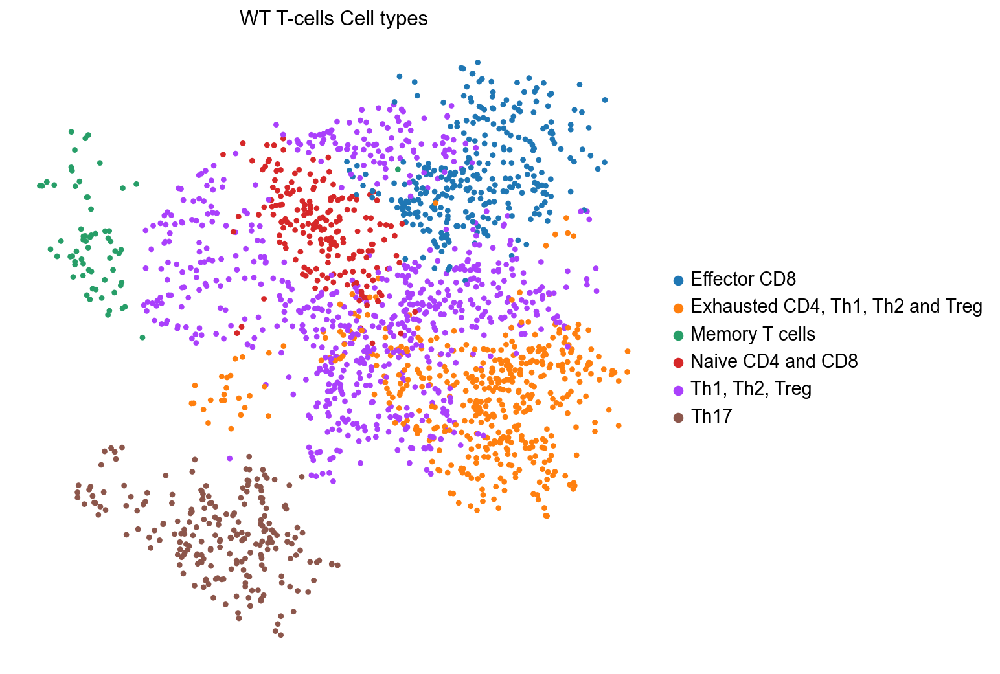

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/anndata/_core/anndata.py:1301: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


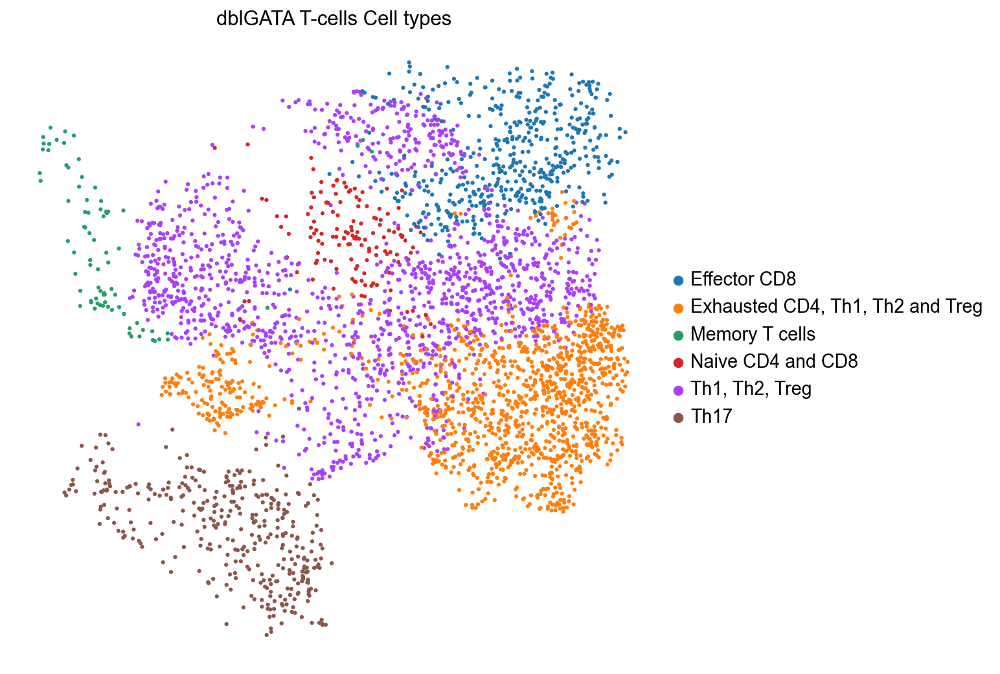

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/anndata/_core/anndata.py:1301: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


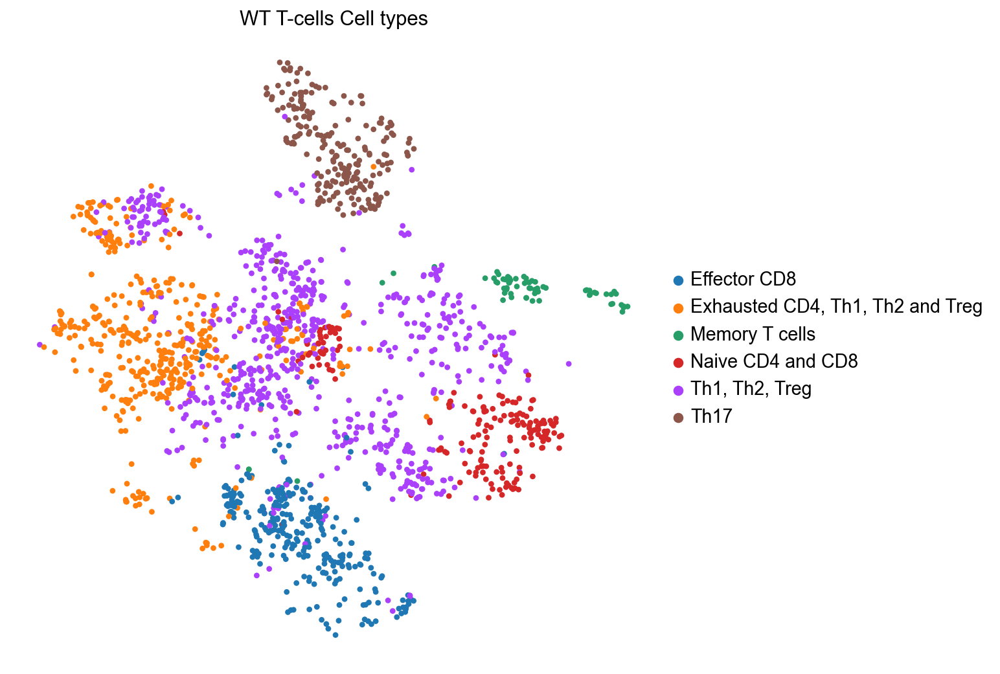

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/anndata/_core/anndata.py:1301: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


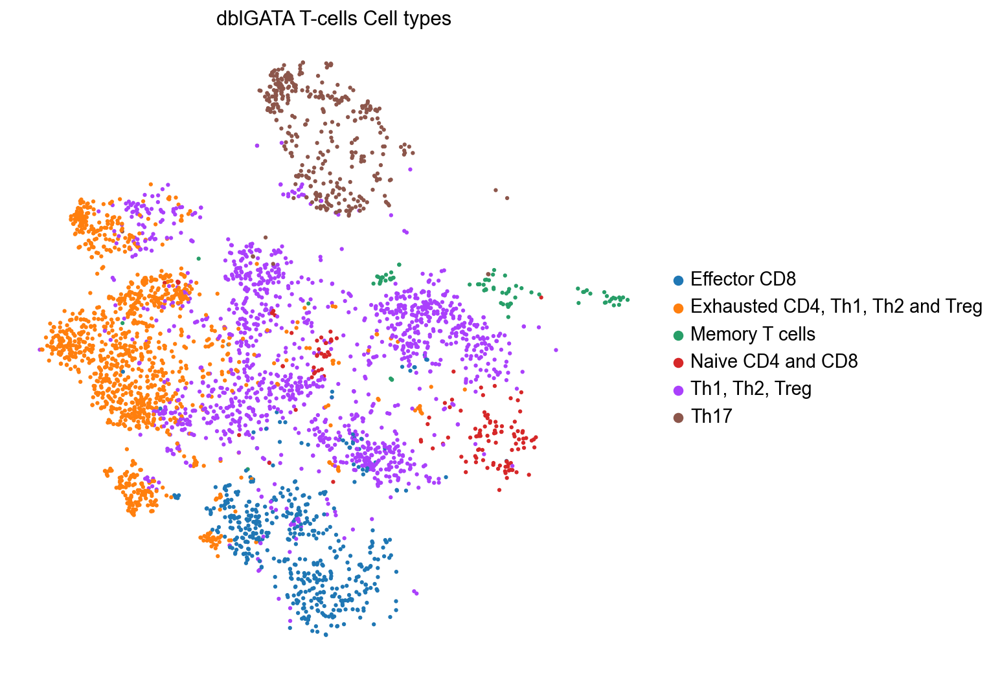

In [23]:
# %% ANNOTATION CELL CLUSTERS in T-cells sub

cell_type_T = {
    '0': "Exhausted CD4, Th1, Th2 and Treg",
    '1': "Effector CD8",
    '2': "Th1, Th2, Treg",
    '3': "Th17",
    '4': "Naive CD4 and CD8",
    '5': "Th1, Th2, Treg",
    '6': "Th1, Th2, Treg",
    '7': "Cont",
    '8': "Memory T cells",
    '9': "Cont",
    '10': "Exhausted CD4, Th1, Th2 and Treg",
    '11': "Cont"
}

adata_T.obs['cell_type'] = adata_T.obs['leiden'].map(cell_type_T)

adata_T = adata_T[adata_T.obs['cell_type'] != 'Cont'].copy()

sc.set_figure_params(figsize=(8, 8))

sc.pl.umap(adata_T[adata_T.obs['sample'] == 'WT_PyMT'], color='cell_type', title='WT T-cells Cell types', frameon=False)
sc.pl.umap(adata_T[adata_T.obs['sample'] == 'dblGATA_PyMT'], color='cell_type', title='dblGATA T-cells Cell types',
           frameon=False)

sc.pl.tsne(adata_T[adata_T.obs['sample'] == 'WT_PyMT'], color='cell_type', title='WT T-cells Cell types', frameon=False)
sc.pl.tsne(adata_T[adata_T.obs['sample'] == 'dblGATA_PyMT'], color='cell_type', title='dblGATA T-cells Cell types',
           frameon=False)


# Save the adata object
adata.write('/home/liza/Documents/PhD/scRNAseq_Inbal/adata.h5ad')

# Save the adata_T object
adata_T.write('/home/liza/Documents/PhD/scRNAseq_Inbal/adata_T.h5ad')

In [24]:
adata[adata.obs['sample'] == 'WT_PyMT'].write('/home/liza/Documents/PhD/scRNAseq_Inbal/adata_WT_PyMT.h5ad')
adata[adata.obs['sample'] == 'dblGATA_PyMT'].write('/home/liza/Documents/PhD/scRNAseq_Inbal/adata_dblGATA_PyMT.h5ad')

In [36]:
# %% Calculate DE genes

def de_analysis_for_cell_type_df(adata, cell_type, sample1, sample2, remove_ribo_mito=True):
    # Subset data for the current cell type
    adata_subset = adata[(adata.obs['cell_type'] == cell_type) & (adata.obs['sample'].isin([sample1, sample2]))]

    # Perform the differential expression analysis
    sc.tl.rank_genes_groups(adata_subset, groupby='sample', reference=sample1)

    # Extract DE genes results
    de_genes = adata_subset.uns['rank_genes_groups']

    # Convert to DataFrame
    results_df = pd.DataFrame({
        'genes': de_genes['names'][sample2],
        'logfoldchanges': de_genes['logfoldchanges'][sample2],
        'pvals': de_genes['pvals'][sample2],
        'pvals_adj': de_genes['pvals_adj'][sample2]
    })

    # Filter out rows where logfoldchanges is NaN or infinite
    results_df = results_df.replace([np.inf, -np.inf], np.nan).dropna(subset=['logfoldchanges'])

    # Filter by pvalue and padj
    filtered_df = results_df[(results_df['pvals'] <= 0.05) & (results_df['pvals_adj'] <= 0.05)]
    return filtered_df
    print(f"Saved DE genes to {filtered_df}")

df_CD8 = de_analysis_for_cell_type_df(adata, 'CD8+', 'WT_PyMT', 'dblGATA_PyMT')
df_CD4 = de_analysis_for_cell_type_df(adata, 'CD4+', 'WT_PyMT', 'dblGATA_PyMT')

ranking genes


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)
ranking genes


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:582: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


In [27]:
cytokins = pd.read_csv('/home/liza/Documents/PhD/Uniprot/uniprotkb_cytokine_mus_musculus_2024_03_04.tsv', sep='\t')

# Split the 'Gene_name' column into lists, then explode those lists into separate rows
cytokins = cytokins.assign(Gene_name=cytokins['Gene_name'].str.split(' ')).explode('Gene_name').drop_duplicates(subset=['Gene_name']).reset_index(drop=True)

# Optional: Reset the index if you want a clean, sequential index after exploding
cytokins = cytokins.reset_index(drop=True)

cytokins.to_csv('/home/liza/Documents/PhD/Uniprot/Cytokins_mus.csv', sep=',', encoding='utf-8', header='true',
          index=False)

cytokins

,Gene_name
0,Tgfb2
1,Gpr15lg
2,Gpr15l
3,Pdgfb
4,Irgm2
...,...
2613,Igkv9-120
2614,EG434025
2615,Gm5571
2616,ifnr


In [28]:
sec_factor = pd.read_csv('/home/liza/Documents/PhD/Uniprot/uniprotkb_secreted_factor_mus_musculus_2024_03_04.tsv', sep='\t')

# Split the 'Gene_name' column into lists, then explode those lists into separate rows
sec_factor = sec_factor.assign(Gene_name=sec_factor['Gene_name'].str.split(' ')).explode('Gene_name').drop_duplicates(subset=['Gene_name']).reset_index(drop=True)

# Optional: Reset the index if you want a clean, sequential index after exploding
sec_factor = sec_factor.reset_index(drop=True)

sec_factor.to_csv('/home/liza/Documents/PhD/Uniprot/Sec_factor_mus.csv', sep=',', encoding='utf-8', header='true',
          index=False)

In [33]:
receptor = pd.read_csv('/home/liza/Documents/PhD/Uniprot/uniprotkb_receptor_mus_musculus_2024_03_04.tsv', sep='\t')

# Split the 'Gene_name' column into lists, then explode those lists into separate rows
receptor = receptor.assign(Gene_name=receptor['Gene_name'].str.split(' ')).explode('Gene_name').drop_duplicates(subset=['Gene_name']).reset_index(drop=True)

# Optional: Reset the index if you want a clean, sequential index after exploding
receptor = receptor.reset_index(drop=True)

receptor.to_csv('/home/liza/Documents/PhD/Uniprot/Receptor_mus.csv', sep=',', encoding='utf-8', header='true',
          index=False)
receptor

,Gene_name
0,Fat1
1,Stat1
2,Tgfb2
3,Fcgr4
4,Fcgr3a
...,...
15487,Mgrg12
15488,Mgrg1
15489,Mgrg6
15490,Mgrg11


In [35]:
tf = pd.read_csv('/home/liza/Documents/PhD/Uniprot/TF.csv', sep=',')

# Split the 'Gene_name' column into lists, then explode those lists into separate rows
tf = tf.assign(Gene_name=tf['Gene_name'].str.split(' ')).explode('Gene_name').drop_duplicates(subset=['Gene_name']).reset_index(drop=True)

# Optional: Reset the index if you want a clean, sequential index after exploding
tf = tf.reset_index(drop=True)

tf.to_csv('/home/liza/Documents/PhD/Uniprot/tf.csv', sep=',', encoding='utf-8', header='true',
          index=False)
tf

,Gene_name
0,Klf6
1,Scmh1
2,Tbx2
3,Tbx4
4,Zfy2
...,...
1363,Gm9046
1364,Gm9040
1365,Gm9049
1366,CT573016.1


In [37]:
df_CD8['Cytokin'] = df_CD8['genes'].isin(cytokins['Gene_name']).map({True: 'cytokin', False: pd.NA})
df_CD8['Sec_factor'] = df_CD8['genes'].isin(sec_factor['Gene_name']).map({True: 'sec_factor', False: pd.NA})
df_CD8['Receptor'] = df_CD8['genes'].isin(receptor['Gene_name']).map({True: 'receptor', False: pd.NA})
df_CD8['TF'] = df_CD8['genes'].isin(tf['Gene_name']).map({True: 'tf', False: pd.NA})


df_CD4['Cytokin'] = df_CD4['genes'].isin(cytokins['Gene_name']).map({True: 'cytokin', False: pd.NA})
df_CD4['Sec_factor'] = df_CD4['genes'].isin(sec_factor['Gene_name']).map({True: 'sec_factor', False: pd.NA})
df_CD4['Receptor'] = df_CD4['genes'].isin(receptor['Gene_name']).map({True: 'receptor', False: pd.NA})
df_CD4['TF'] = df_CD4['genes'].isin(tf['Gene_name']).map({True: 'tf', False: pd.NA})

with pd.ExcelWriter('/home/liza/Documents/PhD/scRNAseq_Inbal/de_genes_Tcells.xlsx') as writer:
    df_CD8.to_excel(writer, sheet_name='CD8+ dblGATA over WT')
    df_CD4.to_excel(writer, sheet_name='CD4+ dblGATA over WT')


ranking genes


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/tmp/ipykernel_17768/3110164728.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['WT Control', 'dblGATA Control', 'WT PyMT', 'dblGATA PyMT'], fontsize=16)


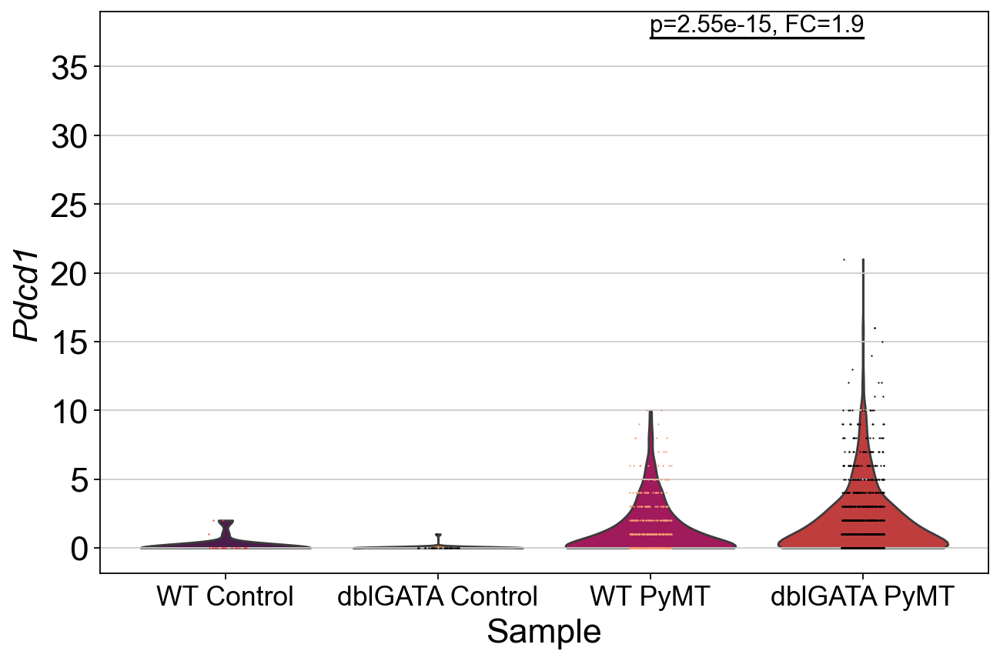

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/tmp/ipykernel_17768/3110164728.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['WT Control', 'dblGATA Control', 'WT PyMT', 'dblGATA PyMT'], fontsize=16)


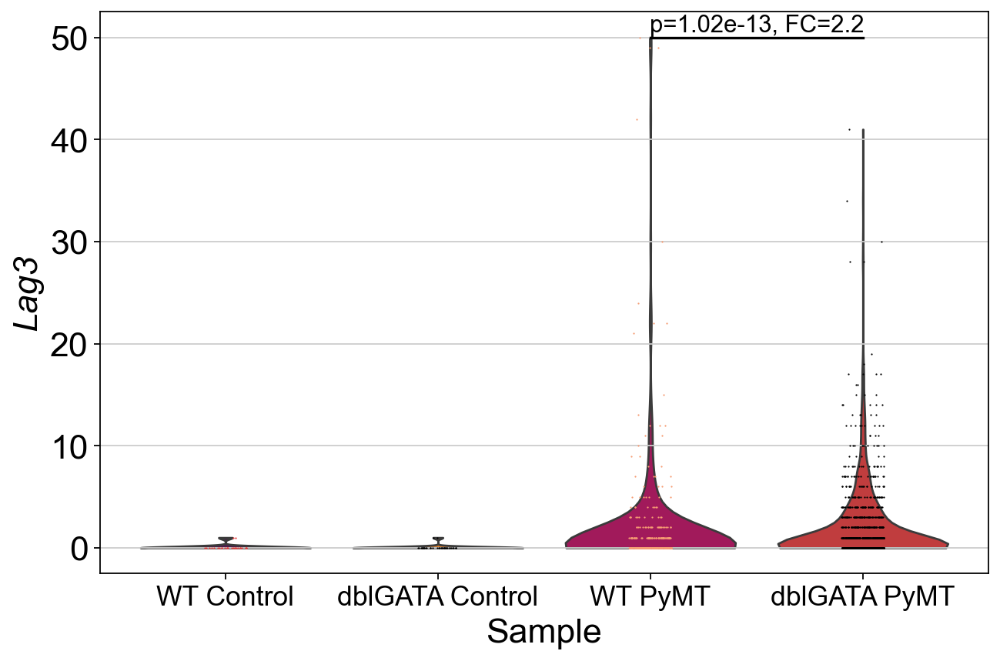

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/tmp/ipykernel_17768/3110164728.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['WT Control', 'dblGATA Control', 'WT PyMT', 'dblGATA PyMT'], fontsize=16)


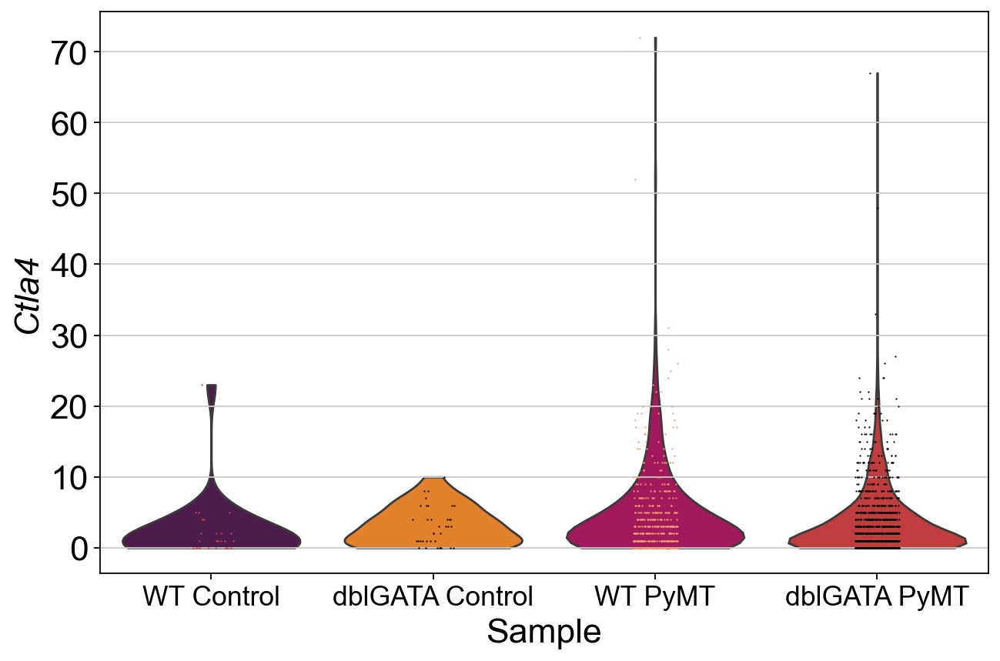

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/tmp/ipykernel_17768/3110164728.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['WT Control', 'dblGATA Control', 'WT PyMT', 'dblGATA PyMT'], fontsize=16)


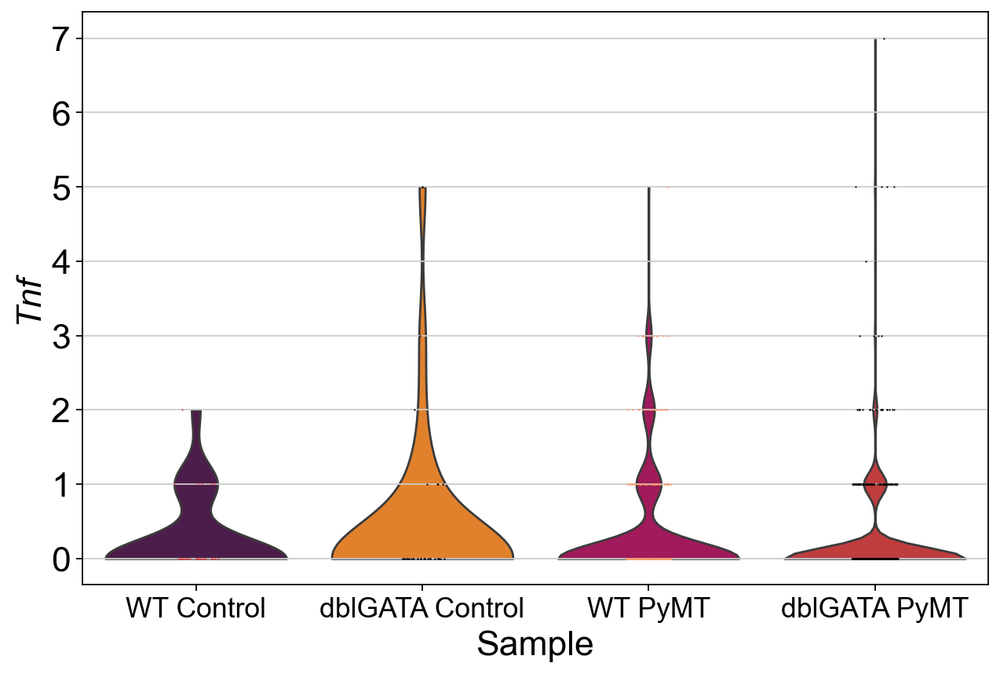

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/tmp/ipykernel_17768/3110164728.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['WT Control', 'dblGATA Control', 'WT PyMT', 'dblGATA PyMT'], fontsize=16)


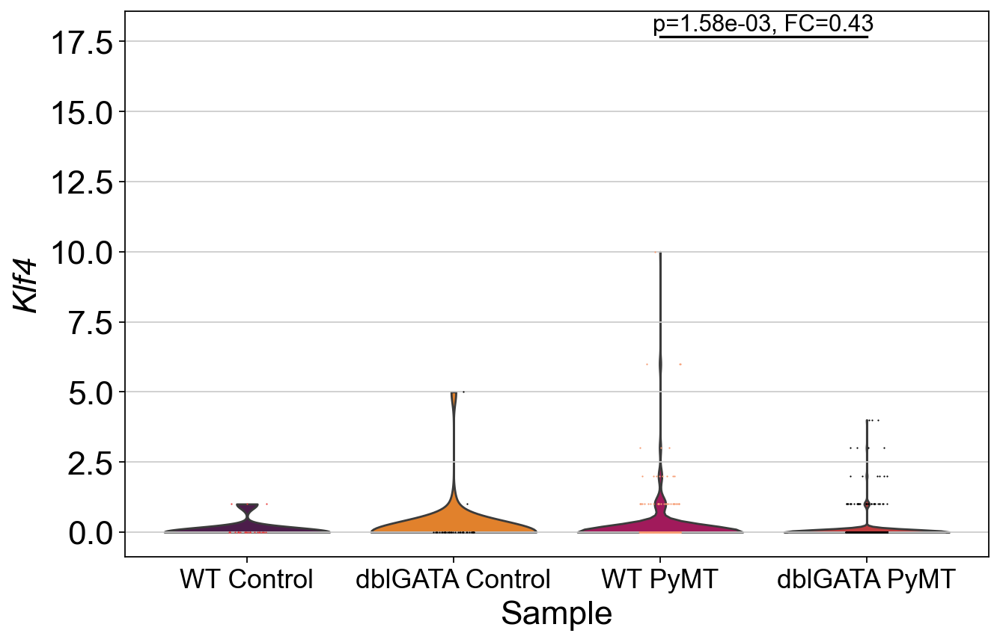

/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.violinplot(
/home/liza/PycharmProjects/jupiterscRNA/.venv/lib/python3.10/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(
/tmp/ipykernel_17768/3110164728.py:32: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['WT Control', 'dblGATA Control', 'WT PyMT', 'dblGATA PyMT'], fontsize=16)


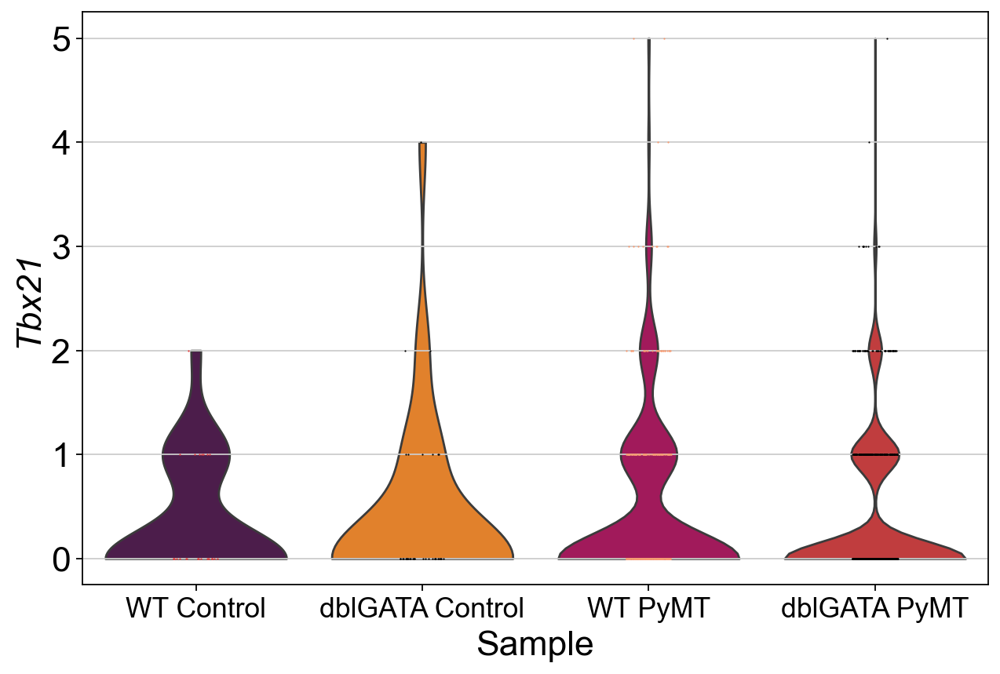

In [101]:
# %% Violin plot

sc.set_figure_params(figsize=(8, 6))

# Subset to the specific cell type of interest
adata_subset = adata_T[adata_T.obs['cell_type'] == 'Exhausted CD4, Th1, Th2 and Treg'].copy()

# List of genes of interest
genes_of_interest = ['Pdcd1', 'Lag3', 'Ctla4', 'Tnf', 'Klf4', 'Tbx21']

# Perform differential expression analysis
sc.tl.rank_genes_groups(adata_subset, groupby='sample', method='wilcoxon')

# Create violin plots and annotate them with p-values
for gene in genes_of_interest:
    # Generate the violin plot
    palette = sns.color_palette('rocket', n_colors=len(adata_T.obs['sample'].unique()))

    
    ax = sc.pl.violin(adata_subset, keys=gene, groupby='sample', use_raw=False, show=False, layer='counts',
                      order=['WT_Control', 'dblGATA_Control', 'WT_PyMT', 'dblGATA_PyMT'])

    # Apply the color palette to the violin plots
    for patch, color in zip(ax.collections[::2], palette):  # ax.collections contains both the violins and their medians
        patch.set_facecolor(color)

    # Change y-tick labels to italic and set font size
    for label in ax.get_yticklabels():
        label.set_fontsize(20)

    ax.set_ylabel(ax.get_ylabel(), fontstyle='italic', fontsize=20)
    ax.set_xticklabels(['WT Control', 'dblGATA Control', 'WT PyMT', 'dblGATA PyMT'], fontsize=16)
    ax.set_xlabel('Sample', fontsize=20)

    # Check if the gene is in the differential expression results
    if gene in df_CD4_Exh_T['genes'].values:
        # Get the p-value for the gene
        pval = df_CD4_Exh_T.loc[df_CD4_Exh_T['genes'] == gene, 'pvals'].values[0]
        logFC = df_CD4_Exh_T.loc[df_CD4_Exh_T['genes'] == gene, 'logfoldchanges'].values[0]
        fold_change = 2 ** logFC

        # Get the positions of the WT_PyMT and dblGATA_PyMT violins
        categories = ['WT_Control', 'dblGATA_Control', 'WT_PyMT', 'dblGATA_PyMT']
        pos_wt = categories.index('WT_PyMT')
        pos_gata = categories.index('dblGATA_PyMT')

        # Set the y position for the annotation to be above the violins
        max_value = max(
            [np.max(adata_subset[adata_subset.obs['sample'] == cat].obs_vector(gene)) for cat in categories])
        y = max_value + (4 * max_value)
        h = 0.01 * max_value  # The height of the lines above the violins

        # Draw the line and annotate the plot with the p-value
        ax.plot([pos_wt, pos_gata], [y, y], lw=1.5, c='k')
        ax.text((pos_wt + pos_gata) / 2, y + h, f'p={pval:.2e}, FC={fold_change:.2}', ha='center', va='bottom',
                color='k')

    # Show the plot
        
    plt.show()




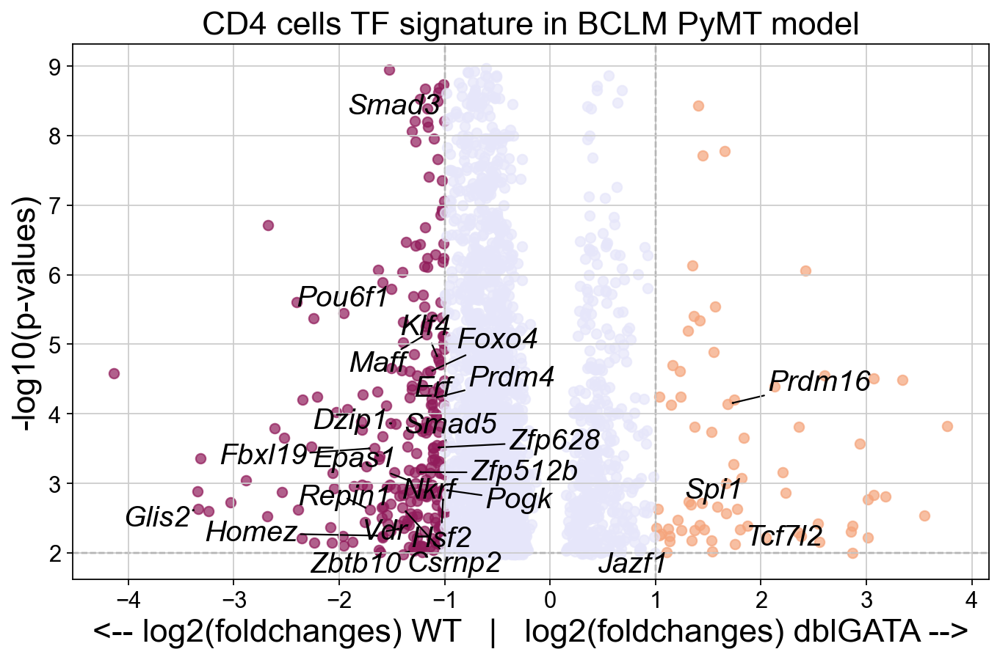

In [48]:
# %% Vulcanoplot

from adjustText import adjust_text

# Create the volcano plot with custom colors
plt.figure(figsize=(10, 6))

genes_of_interest = df_CD4[df_CD4['TF'] == 'tf']['genes'].tolist()


df = df_CD4

df = df[df['pvals'] > 0.000000001]
df = df[(df['logfoldchanges'] > -10) & (df['logfoldchanges'] < 10)]


# Plot genes with different colors based on conditions
plt.scatter(df[df['logfoldchanges'] > 1]['logfoldchanges'], -np.log10(df[df['logfoldchanges'] > 1]['pvals']),
            c='#f5a47b', alpha=0.7, label='UPregulated')
plt.scatter(df[(df['logfoldchanges'] < -1) & (df['pvals'] <= 0.05)]['logfoldchanges'],
            -np.log10(df[(df['logfoldchanges'] < -1) & (df['pvals'] <= 0.05)]['pvals']), c='#911c5b', alpha=0.7,
            label='DOWNregulated')
plt.scatter(
    df[~((df['logfoldchanges'] > 1) | ((df['logfoldchanges'] < -1) & (df['pvals'] <= 0.05)))]['logfoldchanges'],
    -np.log10(
        df[~((df['logfoldchanges'] > 1) | ((df['logfoldchanges'] < -1) & (df['pvals'] <= 0.05)))]['pvals']),
    c='#E6E6FA', alpha=0.7, label='Other Genes')

# Annotate only the genes where "Text" is equal to 1
texts = []
for _, row in df.iterrows():
    if row['genes'] in genes_of_interest:
        if (row['logfoldchanges'] > 1) | (row['logfoldchanges'] < -1):
            texts.append(plt.text(row['logfoldchanges'], -np.log10(row['pvals']), row['genes'], fontsize=18, color='black', fontstyle='italic'))

# Use the adjust_text function to automatically adjust text positions
adjust_text(texts, arrowprops=dict(arrowstyle='->', color='k', lw=1), avoid_self=True)

# Add vertical and horizontal dashed lines
plt.axvline(1, zorder=0, c='k', lw=1, ls='--')
plt.axvline(-1, zorder=0, c='k', lw=1, ls='--')
plt.axhline(2, zorder=0, c='k', lw=1, ls='--')

plt.xlabel('<-- log2(foldchanges) WT   |   log2(foldchanges) dblGATA -->', fontsize=20)
plt.ylabel('-log10(p-values)', fontsize=20)
plt.title('CD4 cells TF signature in BCLM PyMT model', fontsize=20)
# plt.legend()

# Show the plot
plt.show()